#                        Bayesian methods of Machine Learning. (Skoltech)

##         Home assignment 1. ARD regression.  EM-algorithm. 

<img src="https://go2phystech.ru/wp-content/uploads/2021/02/skolteh.jpeg" width=800 height=200 />

### Important information

$\textbf{Deadline}$: 23:59:59, 27 October 2025 (Monday)\
$\textbf{Rules}$:
- You don't have to distribure materials of this homework, they belong to Skoltech.
- You don't have to use the help of other students. (otherwise, 0 points)
- You shouldn't postpone this homework.
- This HW is composed of 4 tasks with according points (1pts, 4 pts, 3 pts, 2pts).
- We created special telegram subgroup for this homework 1, where you can clarify some formal moments.
- You don't have to demonstrate your solution there or ask. (otherwise, 0 points)
- This HW might be appealed during the one week after the announcment of marks in offline format.


Author : Kolesov Alexander 

In [154]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.distributions as TD
import torch.optim as optim

import numpy as np
from sklearn.datasets import make_regression
from sklearn.metrics import r2_score
from IPython.display import Image, display
from IPython.core.display import HTML
from tqdm import tqdm
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import itertools
%matplotlib inline

<img src="https://i.pinimg.com/736x/1c/21/d2/1c21d2bd14896107ad9f8b98892ea139.jpg" width=300 height=100 />

## Task 1. Test (1 pt)

The first block is composed of sufficiently simple questions, which were mentioned in seminars, but they are crucial for understanding concepts of BML. Each right questions costs $\textbf{0.2}$ points. You should write down your answer in correspond cells, that are located below.

### Question 1.1 (0.2 pts):
Are Cauchy and Gumbel distributions conjugate?

$\textbf{Answer}:$

Let's define probability density functions of each distribution:

1. Cauchy - $p(x) = 1 / {\big[ 1 + (\frac{x-x_0}{\gamma})^2 \big]}$
2. Gumbel - $q(x) = \frac{1}{\beta} \times exp(- z - exp(-z))$, $z = \frac{x - \mu}{\beta}$


Let's recall ehat we define as conjugate distributions $p_1$ and $q_1$:


$\quad \quad$We say that distributions are conjugate if $p_1(\theta \mid x)$ and $q_1(\theta)$ are from one family of distributuons or $q_1(\theta \mid x)$ and $p_1(\theta)$ are from one family of distributuons. 

So we need to check if prior and posterior are from one family of distributions:

1. All of these distributions doesn't belong to the exponential family of distributions
2. Consequently, production of likelihood and posterior also doesn't belong to exponential family of distributions.
3. Moreover production of Cauchy and Gumbel distributions also couldn't allow to get Cauchy or Gumbel distributed prior.

In the result, answer is no. Cauchy and Gumbel distributions are not conjugate.

### Question 1.2 (0.2 pts):
Why do we introduce Gaussian distribution for prior, while consideration of Bayesian Linear regression?

$\textbf{Answer}$:

In Bayesian Lineae Regression we consider following task: 
\begin{equation}
y = \textbf{X*w} + \epsilon,\quad \epsilon ~ N(0, \beta^{-1})
\end{equation}

So after that we can get $p(y|X, w, \beta) = N(y|X*w, \beta^{-1})$.

And for likelihood we have: $p(\textbf{y|X}, \textbf{w}, \beta) = \prod_{i=1}^{n} N(y_i| w^T*X_i, \beta^{-1})$.

The posterior $p(\textbf{y|X}, \textbf{w}, \beta)$ has distribution of exponential family, because procution of exponents is also an exponent.

Thefore the corresponding conjugate prior is given by a Gaussian distribution of the form:
\begin{equation}
p(\textbf{w}) = N(\textbf{w}|\mu_0, S_0)
\end{equation}

### Question 1.3 (0.2 pts):
When does Bayesian Linear regression correspond to usual Linear Regression?

$\textbf{Answer}$

Let's here recal for previuos answer. We already have prior and can define posterior:

\begin{equation}
p(\textbf{w}| \text{y}) = N(\textbf{w}|\mu_n, S_n)
\end{equation}

Here, $\quad \mu_n = S_n(S_0^{-1}\mu_0+\beta X^T y)$,$\quad S_n^{-1} = S_0^{-1}+\beta X^T X$.


Let's note that in ordinary least squares (likelihood estimation) we will have $\hat{w}_{ML} = (X^TX)^{-1}X^Ty$

So, let's note if we consider an infinitely broad prior $S_0 = \alpha^{-1}$ with $\alpha \to 0$ we will get:
\begin{equation}
S_n^{-1} = (S_0^{-1}+\beta X^T X)^{-1}(S_0^{-1}\mu_0+\beta X^T y) = (\beta X^T X)^{-1}(\beta X^T y) = (X^T X)^{-1}X^T y
\end{equation}

In the result, Bayesian Linear regression correspond to usual Linear Regression when covarionce of the prior $S_0 = \alpha^{-1}$ with $\alpha \to 0$.

### Question 1.4 (0.2 pts):

How to find covariance matrix $\Sigma$, while you know quadtaric form of $\log p(w|X,y,\alpha,\beta)$ ?

$\textbf{Answer}$:

We have discussed on lecture that covariance matrix $\Sigma$ could be found as the coefficient near the second derivative of $\log p(w|X,y,\alpha,\beta)$ in his Taylor series.

Lets recall Taylor series of $\log f(w)$ from Seminar 2:
\begin{equation}
\log f(w)\approx \log f(w_0) - \frac{1}{2}(w-w_0)^TA(w-w_0), \quad A=-\left.\nabla^2_{w}\log f(w)\right|_{w=w_0}
\end{equation}

Consequently, $\Sigma$ = $-\left.\nabla^2_{w}\log p(w|X,y,\alpha,\beta)\right|_{w=w_0}$

But if we want find covariance matrix we should find inverse one, so we get $\Sigma^{-1}$ = $\big($ $-\left.\nabla^2_{w}\log p(w|X,y,\alpha,\beta)\right|_{w=w_0}$ $\big)^{-1}$

### Question 1.5 (0.2 pts):

What does this term $\int_{z} q(z)\log\frac{q(z)}{p(z|X,\theta)}dz$ in variational inference mean ?

$\textbf{Answer}$:

Let's first recall $KL(q||p) = - \int_z q(z) \log (\frac{p(z|x, \theta)}{q(z)}) dz$.

Then we can state: $ KL(q||p) = \int_z q(z) \log (\frac{q(z)}{p(z|x, \theta)}) dz$.

So in variational inference term $\int_{z} q(z)\log\frac{q(z)}{p(z|X,\theta)}dz$ means$: KL(q||p)$.

## Task 2. ARD-regression (4 pts)

The following task deals with the $\textbf{Automatic Relevance Determination}$ (ARD) regression, whose ingridients are:

- Likelihood of one item: $p(y_n|x_n, w;\beta) = \mathcal{N}(y_n| \textbf{w}^Tx_n, \beta^{-1})$
- Likelihood model for whole data: $p(\textbf{y}|X,\textbf{w};\beta) = \prod\limits_{n=1}^{N}p(y_n|x_n,\textbf{w};\beta) = \mathcal{N}(\textbf{y}|X\textbf{w}, \beta^{-1})$
- Prior model: $p(\textbf{w};\alpha) = \prod\limits_{d=1}^{D}\mathcal{N}(w_d|0, \alpha_d^{-1})=\mathcal{N}(\textbf{w}|0,A^{-1})$

Thus, the Bayesian model has two hyper-parameters. While $\beta$ is value that describes the variance of Likelihood model, $\alpha$ is vector of diagonal elements of matrix $A$. The task is ARD regression is to maximize evidence by tuning more appropriate parameters as $\alpha$ for each feature of data and value $\beta$.

We have alredy the following results at seminar:

\begin{equation*}
\begin{aligned}
& \mu^{new} = \beta(\beta X^T X + A)^{-1}X^T\textbf{t},\\
& \alpha_i^{new} = \frac{1}{\mu^2_i}(1-\Sigma_{ii}^{old}\alpha_i^{old}),\\
& \beta^{new} = \frac{1}{\|t-X\mu\|_2^2}\left(N-\text{trace} (I-\Sigma^{old}A^{old})\right),\\
& \Sigma^{new} = (\beta^{new} X^TX + A^{new})^{-1}.\\
\end{aligned}
\end{equation*}

### Task 2.1. Missing code (2 pts)

You should figure out the code that is located below for ARD class and :

- finish writting of $\it{get}$_$\it{alpha}$ -- (1 pts)
- finish writting of $\it{get}$_$\it{beta}$ --  (1 pts)

In [155]:
class ARD:
    
    def __init__(self, X, y,  beta_0, alpha_0, iters, threshold):
        
        """
        X - shape([N,D])
        y - shape([N,])
        beta_0 - float: variance for likelihood
        alpha_0 - float: diagonal elements of prior matrix
        """
        self.X = X
        self.y = y
        
        # parameters for likelihood model
        self.beta = beta_0
        
        # parameters for prior distribution
        # set diagonal elements of cov matrix
        self.alpha = np.array([alpha_0] * self.X.shape[1]) #[D,]
        
        # necessary calculus
        self.data_cov = self.X.T @ self.X # [D,D]
        self.data_mean = self.X.T @ self.y # [D,1]
        
        # training necessities
        self.iters = iters
        self.threshold = threshold
        self.idx_relevant = np.array(range(self.X.shape[1]))
        
    def get_sigma(self):
        """
        it calculates covariance matrix of log p(w|x,y)
        """
        return np.linalg.inv(self.beta * self.data_cov + np.diag(self.alpha)) 
    
    
    def get_mu(self):
        """
        It calculates expectation of log p(w|x,y)
        """
        return self.beta * self.sigma @ self.data_mean
     
        
    def get_alpha(self, alpha, mu, sigma):
        """
        Making update for alpha
        
        alpha - shape([D,])
        mu    - shape([D,1])
        sigma - shape([D,D])
        """ 
        # your code is here
        return 1 / mu**2 * (1 - np.diagonal(sigma) * alpha)
         
    
    
    def get_beta(self, alpha, mu, sigma):
        """
        Making update for beta 
        
        alpha - shape([D,])
        mu    - shape([D,1])
        sigma - shape([D,D])
        """
        # [N, D] * [D, 1]
        # your code is here
        np.diag(self.alpha)
        norm = np.linalg.norm(self.y - np.dot(self.X, mu))**2
        return 1 / norm * (self.X.shape[0] - np.trace(np.identity(self.X.shape[1]) - sigma * np.diag(alpha)))
        
            
            
    def prune(self):
        
        """
        
        Pruning function is like removing not informative features
        
        """
         
        idx = np.where(self.alpha < self.threshold)[0]
        
        if len(idx) != 0:
            bad = np.where(self.alpha >= self.threshold)[0]
            temp = self.idx_relevant[np.where(self.idx_relevant != -1)] 
            temp[bad] = -1
            self.idx_relevant[np.where(self.idx_relevant != -1)] = temp
            
            self.X = self.X[:, idx]
            self.alpha = self.alpha[idx]
            self.mu = self.mu[idx]
            self.data_cov, self.data_mean = self.X.T @ self.X, self.X.T @ self.y 
            
    def elbo(self):
        """
        metric for method
        """
        N = self.X.shape[0]
        lbound = N * np.log(self.beta) + np.sum(np.log((self.alpha))) -\
        self.beta * np.linalg.norm(self.X @ self.mu - self.y) ** 2\
        - np.sum(self.mu ** 2 * self.alpha) + np.log(np.linalg.det(self.sigma))
        return lbound
    
    def fit(self,prune):
        """
        training function
        """
        for i in range(self.iters):
            self.sigma = self.get_sigma()
            self.mu = self.get_mu()
            self.alpha = self.get_alpha(self.alpha, self.mu, self.sigma)
            self.beta = self.get_beta(self.alpha, self.mu, self.sigma)
              
            if prune is not None:
                self.prune()
            else:
                self.alpha = np.clip(self.alpha, 0., 1e5)
                
            # print(i, self.elbo())
            
        return self.mu, self.sigma, self.alpha, self.beta
    
    def get_relevant_features_prune(self):
        return self.idx_relevant[np.where(self.idx_relevant != -1)]   

### Task 2.2 Tracking method for finding informative features. (0.5 pts)

In this task, we use data from scikit.learn for building regression model and finding informative features.Then :

- Take data for regression with 3 meaningful fearures
- Define parameters for ARD regression. 
- Change parametrs for defining ARD model from  corresponding lists below and expalin your observations(0.25 pts)
- How does result of this task change while we tend $\alpha$ or $\beta$  to 0 and $\infty$?(0.25 pts)

In [156]:
BETA_0 = [0.0001, 0.001, 0.1, 1., 10., 10_000]
ALPHA_0 = [0.0001, 0.001, 0.1, 1., 10., 10_000]
ITERS = [1,10,100,1_000]
THRESHOLD = [1e15,1e5,1e1,10, 0.1]

In [157]:
X, t, coef_true = make_regression(100, 100, n_informative=3, coef=True)
print("=====================================================")
print("weights : ", coef_true)
print("=====================================================")
print("informative features : ",np.where(coef_true != 0)[0])

weights :  [ 0.          0.          0.          0.          0.          0.
  0.          0.          0.         96.547047    0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.         24.47472343  0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
 70.22307739  0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          

In [158]:
np.where(coef_true != 0)[0]

array([ 9, 32, 54])

You should take all possible combinations $\beta$, $\alpha$, 

iters and threshold from correspond lists $\textbf{BETA0}$ , $\textbf{ALPHA0}$ , $\textbf{ITERS}$, $\textbf{THRESHOLD}$ and vary them.

In [159]:
params = list(itertools.product(BETA_0, ALPHA_0, ITERS, THRESHOLD))
model_logs = {
    'elbo': [],
    'mu': [],
    'sigma': [],
    'alpha': [],
    'alpha_0': [],
    'beta_0': [],
    'beta': [],
    'iters': [],
    'threshold': [],
    'features': [],
}

for beta_0, alpha_0, iters, threshold in tqdm(params):
    reg = ARD(
        X, t, beta_0,
        alpha_0,
        iters,
        threshold
    )
    mu, sigma, alpha, beta = reg.fit(True)

    model_logs['iters'].append(iters)
    model_logs['alpha_0'].append(alpha_0)
    model_logs['beta_0'].append(beta_0)
    model_logs['threshold'].append(threshold)
    
    model_logs['elbo'].append(reg.elbo().item())
    model_logs['mu'].append(mu)
    model_logs['sigma'].append(sigma)
    model_logs['alpha'].append(alpha)
    model_logs['beta'].append(beta)

  0%|          | 0/720 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/1785957939.py:53: RuntimeWarning: divide by zero encountered in divide
  return 1 / mu**2 * (1 - np.diagonal(sigma) * alpha)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/1785957939.py:101: RuntimeWarning: divide by zero encountered in log
  - np.sum(self.mu ** 2 * self.alpha) + np.log(np.linalg.det(self.sigma))


In [160]:
mu, sigma, alpha, beta = reg.fit(True)

In [161]:
reg.get_relevant_features_prune()

array([ 9, 32, 54])

Your observations for all possible combinations of aforementioned lists and answer for Task 2.2 is here

In [162]:
# best parametrs bsed on elbo
elbos = np.array(model_logs['elbo'])
elbos[elbos == np.nan] = - np.inf
elbos[elbos == np.inf] = - np.inf
best_index = np.argmax(elbos)

beta_0_best = model_logs['beta_0'][best_index]
alpha_0_best = model_logs['alpha_0'][best_index]
iters_best = model_logs['iters'][best_index]
threshold_best = model_logs['threshold'][best_index]

print('Best elbo:', max(elbos))
print('beta_0: ', beta_0_best)
print('alpha_0: ', alpha_0_best)
print('iters: ', iters_best)
print('threshold: ', threshold_best)

Best elbo: 5954.241151152038
beta_0:  0.0001
alpha_0:  0.001
iters:  10
threshold:  1000000000000000.0


In [163]:
def plot_distribution_param(elbos, specific_params, params_set, name):
    for param in specific_params:
        plt.figure()
        indexes = params_set == param
        plt.scatter(params_set[indexes], elbos[indexes])
        plt.title(f'ELBO - {name} {param}')
        plt.xlabel(f'{name} = {param}')
        plt.ylabel('ELBO')
        plt.grid(True)
        plt.tight_layout()

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/1169589865.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


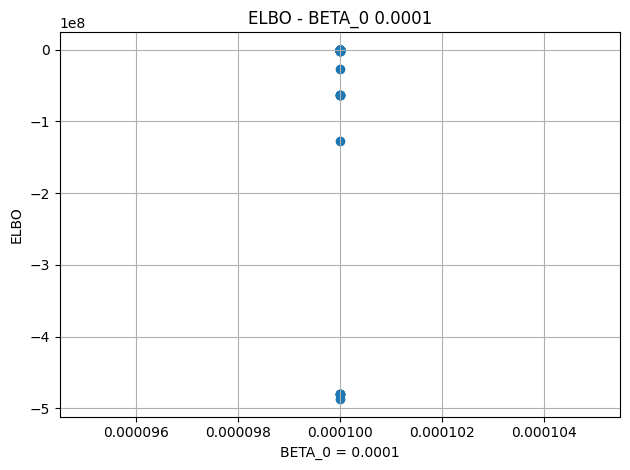

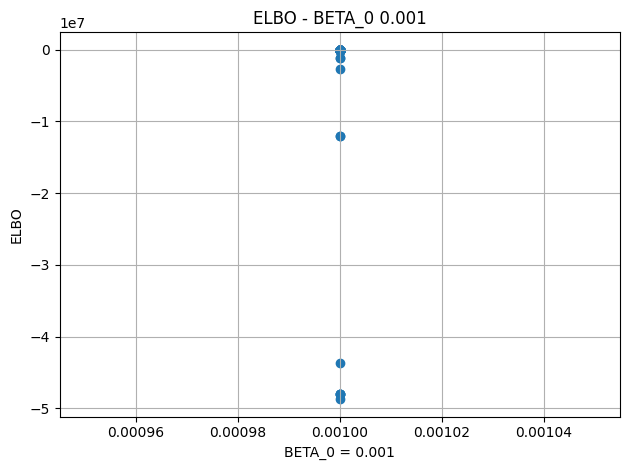

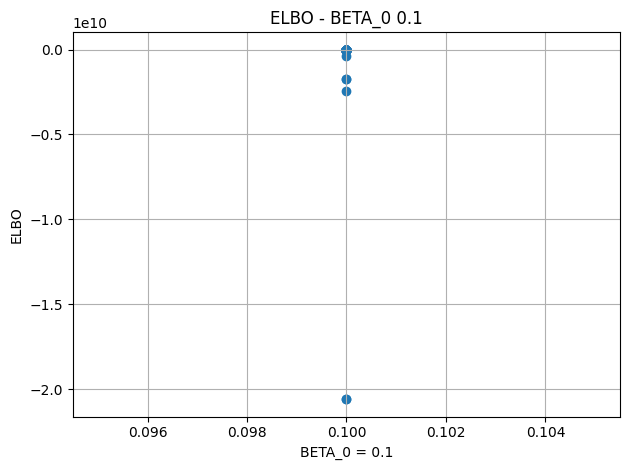

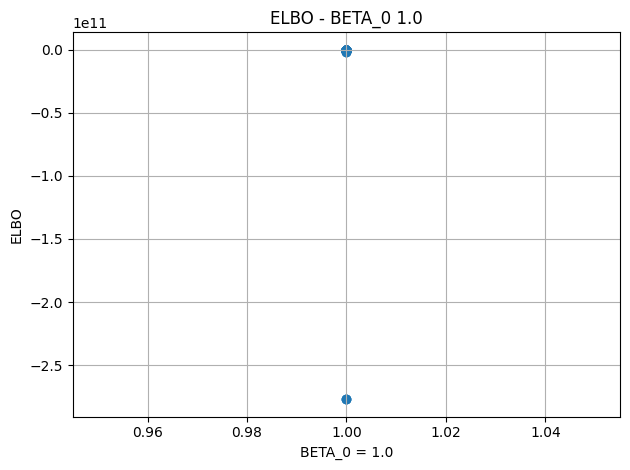

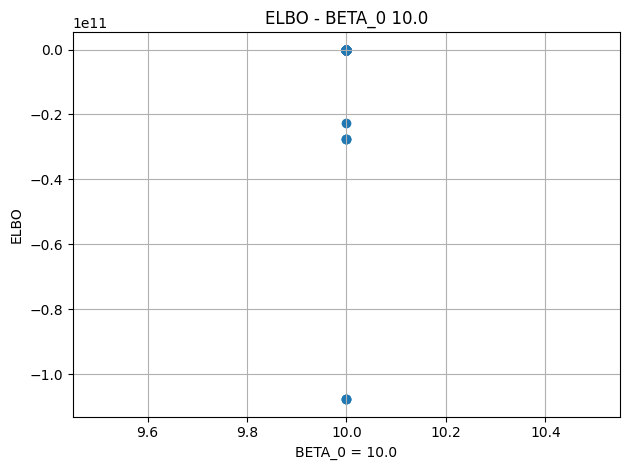

...

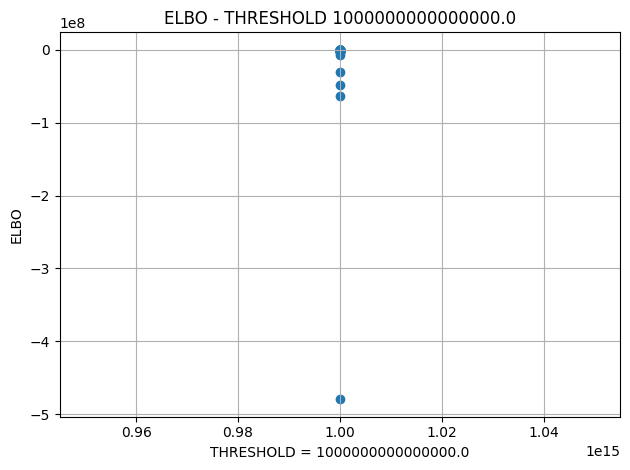

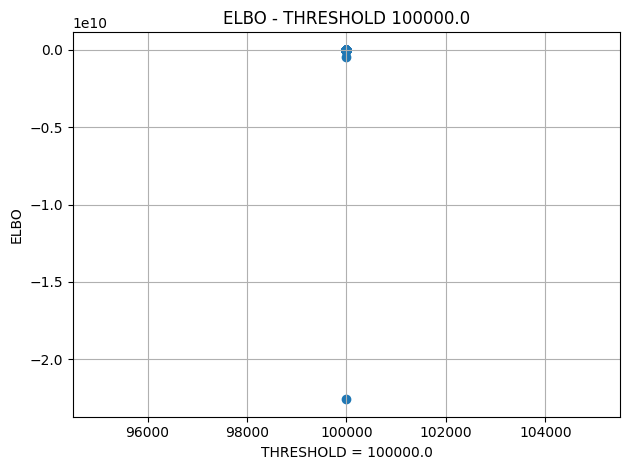

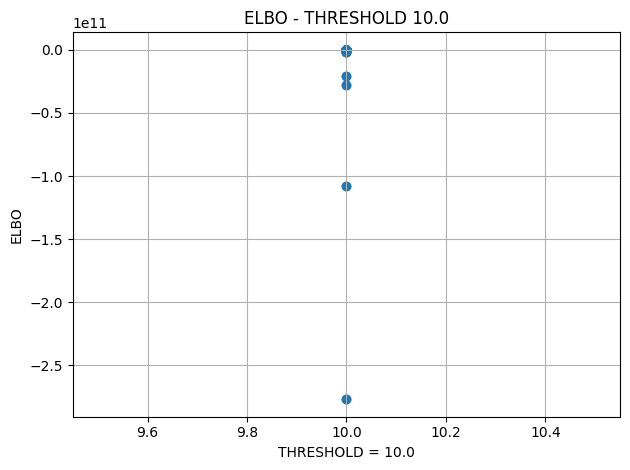

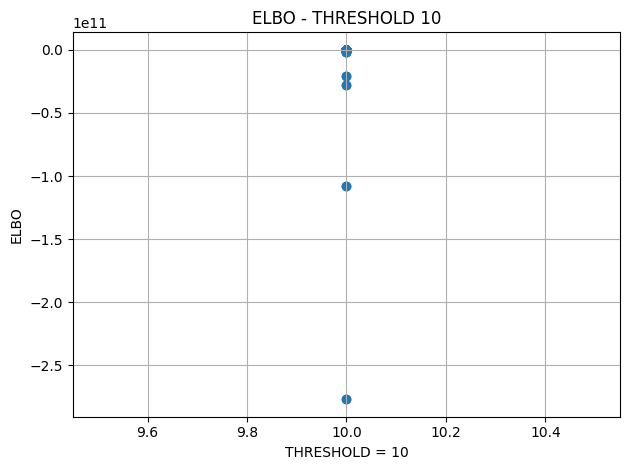

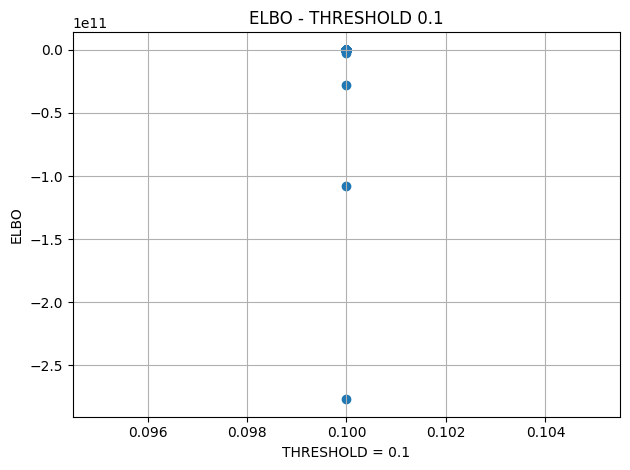

In [164]:
# distribution of elbo based on each param
index_real_num = np.isfinite(elbos)

elbos_ = elbos[index_real_num]
betas_0= np.array(model_logs['beta_0'])[index_real_num]
alphas_0 = np.array(model_logs['alpha_0'])[index_real_num]
iters_ = np.array(model_logs['iters'])[index_real_num]
threshold_ = np.array(model_logs['threshold'])[index_real_num]

plot_distribution_param(elbos_, BETA_0, betas_0, 'BETA_0')
plot_distribution_param(elbos_, ALPHA_0, alphas_0, 'ALPHA_0')
plot_distribution_param(elbos_, ITERS, iters_, 'ITERS')
plot_distribution_param(elbos_, THRESHOLD, threshold_, 'THRESHOLD')

Here is scatter scatter plot of distribution of each parametr based on ELBO.


It is seen that, if we will consider each parametr alone, each parametr could maximise or minimise ELBO. For example, it is seen for ALPHA or BETA that ELBO hesitate near maximum and minimum, because wide range of values are covered with ech param.


But, stil some parametrs as threshold and iters hesitate with lower frequency. And it is predctible, because aloha or better have better impact on the model.

-----------------------------------------------------------------------------------------
-----------------------------------------------------------------------------------------

How does result of this task is changed while we tend $\alpha$ or $\beta$  to 0 and $\infty$?(0.25 pts)

Now, let's check what will be with model with very big and small beta and alpha.

Let's fix all the params except beta or alpha.

In [166]:
##### -----------------------------------------------------
########### ERROR SHOULD APEAR HERE ########################
##### -----------------------------------------------------

BETA_0_new = [1e-15, 0.00000001, 0.0001, 0.001, 0.1, 1, 100, 10_000, 1e15]
ALPHA_0_new = [1e-15, 0.00000001, 0.0001, 0.001, 0.1, 1., 100, 10_000, 1e15]

params_new = list(itertools.product(BETA_0_new, ALPHA_0_new))
model_logs_new = {
    'elbo': [],
    'alpha_0': [],
    'beta_0': []
}

for beta_0, alpha_0 in tqdm(params_new):
    reg = ARD(
        X, t, beta_0,
        alpha_0,
        iters_best,
        threshold_best
    )
    mu, sigma, alpha, beta = reg.fit(True)

    model_logs_new['alpha_0'].append(alpha_0)
    model_logs_new['beta_0'].append(beta_0)
    model_logs_new['elbo'].append(reg.elbo().item())


##### -----------------------------------------------------
########### ERROR SHOULD APEAR HERE ########################
##### -----------------------------------------------------

  0%|          | 0/81 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/1785957939.py:53: RuntimeWarning: divide by zero encountered in divide
  return 1 / mu**2 * (1 - np.diagonal(sigma) * alpha)


LinAlgError: Singular matrix

If we make $\alpha$ of $\beta$ very smal about 1e-15 or very big 1e15 then algorithm doesn't work, because it can find inverse of zeros.


Let's consider bigger numbers

In [167]:
BETA_0_new = [1e-7, 0.0001, 0.001, 0.1, 1, 100, 10_000, 1e10]
ALPHA_0_new = [1e-7, 0.0001, 0.001, 0.1, 1., 100, 10_000, 1e10]

params_new = list(itertools.product(BETA_0_new, ALPHA_0_new))
model_logs_new = {
    'elbo': [],
    'alpha_0': [],
    'beta_0': []
}

for beta_0, alpha_0 in tqdm(params_new):
    reg = ARD(
        X, t, beta_0,
        alpha_0,
        iters_best,
        threshold_best
    )
    mu, sigma, alpha, beta = reg.fit(True)

    model_logs_new['alpha_0'].append(alpha_0)
    model_logs_new['beta_0'].append(beta_0)
    model_logs_new['elbo'].append(reg.elbo().item())

  0%|          | 0/64 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/1785957939.py:53: RuntimeWarning: divide by zero encountered in divide
  return 1 / mu**2 * (1 - np.diagonal(sigma) * alpha)


Let's find out how many nans or infs there:

In [168]:
all_len = len(model_logs_new['elbo'])     
nans = np.isfinite(model_logs_new['elbo']).sum()

print(f'All iterations = {all_len}, nans or infs = {nans}')

All iterations = 64, nans or infs = 23


Almost half of the iterations are nans. Model doesn't converge if we will tend beta of alpha to infinity or zero, because there is no numericall stability when computing inverse matrices.


-----------------------------------------------------------------------------------------------------

### Task 2.3 Comparison with ML solutions in polynomial tasks. (1.5 pts)



In [169]:
def gen_batch(n, w, beta):
    """
    funciton for creating batch along polynomial function
    """
    d = len(w)
    X = np.random.uniform(-1, 1, (n, 1))
    X = np.sort(X, axis=0)
    X = np.hstack([X ** i for i in range(d)])
    t = X.dot(w) + np.random.normal(size=n) / beta ** 0.5
    return X, t

In [170]:
n = 200
d = 21
w_true = np.zeros(d)
w_true[1] = 1
w_true[3] = -1
beta_true = 100

# train , test
X_train, t_train = gen_batch(n, w_true, beta_true)
X_test, t_test = gen_batch(n, w_true, beta_true)

In [171]:
X_train.shape, t_train.shape, X_test.shape , t_test.shape

((200, 21), (200,), (200, 21), (200,))

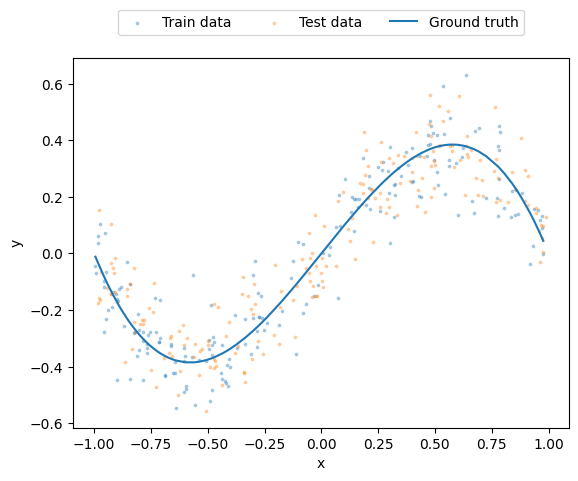

In [172]:
# Visualization of data
fig, ax = plt.subplots()
ax.scatter(X_train[:, 1], t_train, s=3, label='Train data', alpha=0.3)
ax.scatter(X_test[:, 1], t_test, s=3, label='Test data', alpha=0.3)
ax.plot(X_train[:, 1], X_train.dot(w_true), label='Ground truth')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.legend(ncol=3, loc=9, bbox_to_anchor=(0.5, 1.15))
plt.show()

In [173]:
model_logs_rvr = {
    'elbo': [],
    'alpha': [],
    'beta': [],
    'iters': [],
    'threshold': []
}

for beta_0, alpha_0, iters, threshold in tqdm(params):
    reg = ARD(
        X_train, t_train, beta_0,
        alpha_0,
        iters,
        threshold
    )
    mu, sigma, alpha, beta = reg.fit(True)

    model_logs_rvr['threshold'].append(threshold)
    model_logs_rvr['iters'].append(iters)
    model_logs_rvr['elbo'].append(reg.elbo().item())
    model_logs_rvr['alpha'].append(alpha_0)
    model_logs_rvr['beta'].append(beta_0)

  0%|          | 0/720 [00:00<?, ?it/s]

In [69]:
elbos = np.array(model_logs_rvr['elbo'])
elbos[elbos == np.nan] = - np.inf
elbos[elbos == np.inf] = - np.inf
best_index = np.argmax(elbos)

beta_0_best = model_logs_rvr['beta'][best_index]
alpha_0_best = model_logs_rvr['alpha'][best_index]
iters_best = model_logs_rvr['iters'][best_index]
threshold_best = model_logs_rvr['threshold'][best_index]

In [70]:
reg = ARD( X_train, t_train, 
          beta_0=beta_0_best,
          alpha_0=alpha_0_best,
          iters=iters_best,
          threshold=threshold_best
)

In [71]:
w_rvr, sigma_rvr, alpha_rvr, beta_rvr = reg.fit(True)

In [72]:
w = np.zeros(X_train.shape[-1])
w[reg.get_relevant_features_prune()] = w_rvr
w_rvr=w

In [73]:
def l2_error(X, t, w):
    return np.sum((X.dot(w.ravel()) - t) ** 2)

#### Training Ridge regression

In [74]:
# Ridge Regression with Cross-Validation
from sklearn.linear_model import RidgeCV
ridge = RidgeCV(cv=20, alphas=10.**np.linspace(-6, 3, 100),
                fit_intercept=False).fit(X_train, t_train)
w_ridge = ridge.coef_

#### Training Lasso regression

In [75]:
# Lasso Regression with Cross-Validation
from sklearn.linear_model import LassoCV, Lasso
lasso = LassoCV(cv=5, alphas=10.**np.linspace(-6, 3, 100),
                fit_intercept=False, max_iter=2000000).fit(X_train, t_train)
w_lasso = lasso.coef_

### Outcome of the task

You should add some calcualtions:

- Features remaining (informative features)  for RVR ? (0.25 pts)
- Features remaining (informative features)  for Lasso ? (0.25 pts)

In [85]:
def get_informative_features(coefs, eps=1e-3):
    c = np.asarray(coefs).astype(float).ravel()
    mask_nonzero = np.isfinite(c) & (np.abs(c) > eps)
    
    scores = np.abs(c)
    informative = mask_nonzero
    
    idx = np.flatnonzero(informative)
    return idx, c[idx]

In [86]:
get_informative_features(w)[0], get_informative_features(w_lasso)[0]

(array([1, 3]), array([ 0,  1,  2,  3,  4, 14, 16, 17, 19]))

Relevance Vector Regression
Features remaining: [1 3] / 21
Train error: 0.010959785839697193
Test error:  0.007842077094223828
--------------------------------------------------
Ridge Regression
Features remaining: NA (no sparsity)
Train error: 0.010751389584002907
Test error:  0.008609015392302168
--------------------------------------------------
Lasso Regression
Features remaining: [ 0  1  2  3  4 14 16 17 19] / 21
Train error: 0.010538988403880034
Test error:  0.008515633208006109


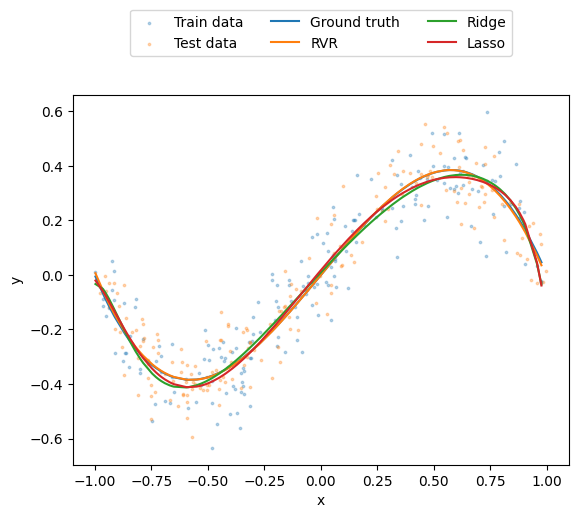

In [87]:
# Comparison
print('Relevance Vector Regression')
print('Features remaining:',  get_informative_features(w)[0] ,  '/', d)
print('Train error:', l2_error(X_train, t_train, w_rvr) / n)
print('Test error: ', l2_error(X_test, t_test, w_rvr) / n)
print('-'*50)
print('Ridge Regression')
print('Features remaining: NA (no sparsity)')
print('Train error:', l2_error(X_train, t_train, w_ridge) / n)
print('Test error: ', l2_error(X_test, t_test, w_ridge) / n)
print('-'*50)
print('Lasso Regression')
print('Features remaining:', get_informative_features(w_lasso)[0], '/', d)
print('Train error:', l2_error(X_train, t_train, w_lasso) / n)
print('Test error: ', l2_error(X_test, t_test, w_lasso) / n)

fig, ax = plt.subplots()
ax.scatter(X_train[:, 1], t_train, s=3, label='Train data', alpha=0.3)
ax.scatter(X_test[:, 1], t_test, s=3, label='Test data', alpha=0.3)
ax.plot(X_train[:, 1], X_train.dot(w_true), label='Ground truth')
ax.plot(X_train[:, 1], X_train.dot(w_rvr), label='RVR')
ax.plot(X_train[:, 1], X_train.dot(w_ridge), label='Ridge')
ax.plot(X_train[:, 1], X_train.dot(w_lasso), label='Lasso')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.legend(ncol=3, loc=9, bbox_to_anchor=(0.5, 1.25))
plt.show()

You should answer to the following questions:
    
- Describe results of test error for each method: RVR, Lasso, Ridge (0.5 pts)
- How many features is used by RVR, Lasso and Ridge ? (0.5 pts)

In [88]:
w_ridge

array([ 0.0092151 ,  0.89081488, -0.16453965, -0.54092707,  0.15776139,
       -0.31293498,  0.12205627, -0.11779038,  0.05399631, -0.02563069,
        0.00105369,  0.00921949, -0.03416767,  0.01753963, -0.05447753,
        0.01450306, -0.06326181,  0.00698564, -0.06362581, -0.00205889,
       -0.0581251 ])

In [89]:
w_lasso

array([ 0.01732247,  0.98608831, -0.27301968, -0.95728501,  0.42488139,
        0.        ,  0.        ,  0.        , -0.        , -0.        ,
       -0.        , -0.        , -0.        , -0.        , -0.10707724,
       -0.        , -0.15956216, -0.04687981, -0.        , -0.06176254,
       -0.        ])

In [90]:
w

array([ 0.00000000e+00,  1.00577651e+00,  0.00000000e+00, -1.01785969e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00, -2.16507874e-14,
        0.00000000e+00, -1.38915667e-11,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00, -9.69175212e-13,  0.00000000e+00, -2.55209486e-05,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00, -9.66705956e-11,
        0.00000000e+00])

1. Describe results of test error for each method: RVR, Lasso, Ridge (0.5 pts):

   First of all, if we based on the graph above and not rerun notebook then it is clear that the best model based on Train error is Lasso, 2nd is Ridge, 3rd is RVR. But we also should say that if we resample train and test data than Ridge, RVR and Lasso demonstarte almost the same (good and close to original data) metrics on train. Also, here is seen that on test data RVR showes the best metrcis and also it should be said that difference between RVR and Ridge or Lasso is bigger than difference between Ridge and Lasso.

2. How many features is used by RVR, Lasso and Ridge ? (0.5 pts)

   In cells above it is seen that RVR gives to some features the biggest weights (among all models), but also it should be mentioned that all features that have big weights in Lasso also have very big weights in RVR. But RVR nullifies more features that Lasso, and moreover demonostartes better metrics on test. Ridge regression nullifies lower number of features, but still the 1st (if we start count from 0) feature has the biggest absolute value for each of model weights, and it is seen that some weights have very low values if compare to other values of Ridge model weights.

---------------------------------------------------------------------
   ---------------------------------------------------------------------

## Task 3. Variational EM algorithm for Gaussian Mixture Models (3 pts)

Let $X = X_{1},...,X_{n}$ are samples that are described by paramteric $k$-component GMM(Gaussian Mixture Model) distribution $p(x|\theta)$ with the following parameters $\theta = {\pi_{1:k},\mu_{1:k},\Sigma_{1:k}}$.

In the seminar, we accurately recalculated parameters of posterior distribution. Now, let posterior distribution $q(z|x, \phi)$ will be parametrized as neural network with own parameters $\phi$. To provide that this neural net is distribution, we add $\textbf{softmax}$ as the final layer of this net.

Thus, we have two sets of parameters: $\phi$ of posterior and $\theta$ of GMM model.

We are looking for the distribution $q(z | x, \phi)$ and $\theta = \{ \boldsymbol{\pi}_{1:K}, \boldsymbol{\mu}_{1:K}, \boldsymbol{\Sigma}_{1:K} \}$ which maximizes the **ELBO** functional:

$$
L(q, \theta) = \int\limits_{\boldsymbol{Z}} q(\boldsymbol{z} | \boldsymbol{X}, \phi) \log \frac{p(\boldsymbol{X}| \boldsymbol{z}, \theta)p(\boldsymbol{z} | \theta)}{q(\boldsymbol{z} | \boldsymbol{X}, \phi)} d \boldsymbol{z} =\\= \sum\limits_{n = 1}^{N} \int\limits_{z_n} q(z_n | X_n, \phi) \log \frac{p(X_n | z_n, \theta) p(z_n | \theta)}{q(z_n | X_n, \phi)} d z_n =\\=
\sum\limits_{n = 1}^{N} \left(\int\limits_{z_n} q(z_n | X_n, \phi) \log p(X_n, z_n | \theta) d z_n - \int\limits_{z_n} q(z_n | X_n, \phi) \log q(z_n | X_n, \phi) d z_n\right) =\\=
\sum\limits_{n = 1}^{N} \Big{(}E_{z_n \sim q(z_n | X_n, \phi)} \log p(X_n, z_n | \theta) + H\big{(}q(z_n | X_n, \phi)\big{)} \Big{)}
$$


Thus, in accordance with the theory of EM algorithm we have the following optimization procedure.

**E-step**

$\phi_{k + 1} = \phi_{k} + \eta \nabla_{\phi} L(q(\cdot| \boldsymbol{X}, \phi), \theta_k)|_{\phi=\phi_{k}}$

**M-step**

$\theta_{k + 1} = \theta_{k} + \eta \nabla_{\theta} \sum\limits_{n = 1}^{N} \Big{(}E_{z_n \sim q(z_n | X_n, \phi_{k + 1})} \log p(X_n, z_n | \theta)\Big{)}\Big{|}_{\theta = \theta_{k}}$

### 3.1 Utils function

In [95]:
DEVICE = 'cpu'
TICKS_FONT_SIZE = 12
LEGEND_FONT_SIZE = 12
LABEL_FONT_SIZE = 14
TITLE_FONT_SIZE = 16
np.random.seed(46)
torch.manual_seed(47)

In [96]:
def visualize_2d_densities(x_grid, y_grid, densities, title, xlabel=None, ylabel=None):
    densities = densities.reshape([y_grid.shape[0], y_grid.shape[1]])
    plt.figure(figsize=(5, 5))
    plt.pcolor(x_grid, y_grid, densities)
    plt.pcolor(x_grid, y_grid, densities)

    plt.title(title, fontsize=TITLE_FONT_SIZE)
    plt.xticks(fontsize=TICKS_FONT_SIZE)
    plt.yticks(fontsize=TICKS_FONT_SIZE)
    if xlabel is not None:
        plt.xlabel(xlabel, fontsize=LABEL_FONT_SIZE)
    if ylabel is not None:
        plt.ylabel(ylabel, fontsize=LABEL_FONT_SIZE)
    plt.show()

In [97]:
def draw_contour(density, X, Y, title, n_levels=3):
    plt.figure(figsize=(5, 5))
    density = density.reshape(X.shape)
    levels = np.linspace(np.min(density), np.max(density), n_levels)
    plt.contour(X, Y, density, levels=levels, c='red')
    plt.title(title, fontsize=16)
    plt.show()

def draw_distrib(distrib, title, n_levels=20, x_lim=(-11, 11), y_lim=(-11, 11),
                 dx=0.1, dy=0.1, device=DEVICE, contour=True, density=True):
    y, x = np.mgrid[slice(y_lim[0], y_lim[1] + dy, dy),
                    slice(x_lim[0], x_lim[1] + dx, dx)]
    mesh_xs = np.stack([x, y], axis=2).reshape(-1, 2)
    densities = torch.exp(distrib.log_prob(torch.tensor(mesh_xs).to(device))).detach().cpu().numpy()
    if contour:
        draw_contour(densities, x, y, title='{} contour'.format(title), n_levels=20)
    if density:
        visualize_2d_densities(x, y, densities, title='{} pdf'.format(title))

### 3.2 GMM class

It is base class for GMM model  that defines the model of K-component GMM.

- function $\textit{gmm}$ makes GMM
- function $\textit{init}$ defines your model (means, weights and covarinces)
- funciton $\textit{prob_X_zs}$ computes the matrix of probabilities $p(X, Z | \theta)$ that we have in ELBO in the last formula above.

In [98]:
class GMM(nn.Module):
    
    @property
    def mu(self):
        return self._mu
    
    @mu.setter
    def mu(self, val):
        self._mu = nn.Parameter(val)

    @property
    def sigma(self):
        return self._L @ self._L.transpose(1, 2)
    
    @sigma.setter
    def sigma(self, val):
        self._L = nn.Parameter(torch.cholesky(val))

    @property
    def pi(self):
        return F.softmax(self._log_pi)

    @pi.setter
    def pi(self, val):
        assert val.min() > 0.
        val = val/torch.sum(val)
        self._log_pi = nn.Parameter(torch.log(val))

    @property
    def gmm(self):
        mix = TD.Categorical(self.pi)
        mv_normals = TD.MultivariateNormal(self.mu, scale_tril=self._L)
        gmm = TD.MixtureSameFamily(mix, mv_normals)
        return gmm

    
    def __init__(self, K, dim, mu=None, sigma=None, pi=None):
        '''
        Define a model with known number of clusters and dimensions.
        :Parameters:
            - K: Number of Gaussian clusters
            - dim: Dimension 
            - mu: means of clusters (K, dim)
                       (default) random from uniform[-10, 10]
            - sigma: covariance matrices of clusters (K, dim, dim)
                          (default) Identity matrix for each cluster
            - pi: cluster weights (K,)
                       (default) equal value to all cluster i.e. 1/K
        '''
        super().__init__()
        self.K = K
        self.dim = dim
        
        if mu is None:
            mu = np.random.rand(K, dim)*20 - 10
        self.mu = torch.tensor(mu) # (K, D)
        
        if sigma is None :
            sigma = np.zeros((K, dim, dim))
            for i in range(K):
                sigma[i] = np.eye(dim)
        self.sigma = torch.tensor(sigma) # (K, D, D)
        
        assert torch.allclose(self.sigma, torch.tensor(sigma))
        if pi is None:
            pi = np.ones(self.K)/self.K
        self.pi = torch.tensor(pi) # (K,)
        
    def log_prob(self, X):
        '''
        Compute the log-prob of each element in X
        input:
            - X: Data (batch_size, dim)
        output:
            - log-likelihood of each element in X: log Sum_k pi_k * N( X_i | mu_k, sigma_k ))
        '''
        return self.gmm.log_prob(X)
    
    def sample(self, shape):
        return self.gmm.sample(shape)
    
    def prob_X_Zs(self, X):
        '''
        Computes the matrix of probabilities p(X, Z | \theta)
        for all possible Z_i \in \{1, 2, \dots K\}
        :Parameters:
        X : tensor (N, D)
        :Output:
        out : tensor (N, K)
        '''
        mv_normals = self.gmm._component_distribution
        X_expanded = X.unsqueeze(-2).repeat(1, self.K, 1) # (N, K, 2)
        log_probs_unw = mv_normals.log_prob(X_expanded) # (N, K)
        log_probs_w = torch.exp(log_probs_unw) * self.pi.unsqueeze(0) # (N, K)
        return log_probs_w


As you may have alredy guessed before, one can calculate $p(x,z|\theta)$ thanks to $\textbf{ GMM_VariationalEM.gmm_model.prob_X_Zs}$. But in order to calculate $H(q(Z|X,\phi))$ we set this distribution as neural network. Then, we should define class for variational EM with the help of previous class.

### Task :

- Define distribution $q$ as neural network (1 pt)
- write line where we set log_p_x_zs in function ELBO_objective (1 pt)

In [99]:
class GMM_VariationalEM(nn.Module):
    
    # freeze parameters models
    @staticmethod
    def freeze(model):
        for p in model.parameters():
            p.requires_grad_(False)
        model.eval()

        
    #unfreeze parameters of model
    @staticmethod
    def unfreeze(model):
        for p in model.parameters():
            p.requires_grad_(True)
        model.train(True)
      
    
    @property
    def gmm_model(self):
        '''
        returns trained GMM model
        '''
        return self.p_theta

    
    
    def __init__(self, K, dim, mu=None, sigma=None, pi=None):
        '''
        Define a model with known number of clusters and dimensions.
        :Parameters:
            - K: Number of Gaussian clusters
            - dim: Dimension 
            - mu: means of clusters (K, dim)
            - sigma: covariance matrices of clusters (K, dim, dim)
            - pi: cluster weights (K,)
        '''
        super().__init__()
        # p_theta is p(x, z | theta)
        self.p_theta = GMM(K, dim, mu, sigma, pi)
        
        
        # model is done as Neural network model
        self.q =  nn.Sequential(
            nn.Linear(dim, 32),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(32, 64),
            nn.ReLU(),
            nn.BatchNorm1d(64),
            nn.Linear(64, 16),
            nn.ReLU(),
            nn.Linear(16, K),
            nn.Softmax(dim=1)
        )
        
    def ELBO_objective(self, X, E_step=False, reduction='sum'):
        '''
        Returns the full ELBO objective
        :Parameters:
        X : tensor (bs, D) : batch of samples
        '''
        eps = 1e-8 # we add eps to stabilize the learning and eliminate nan's 
        assert reduction in ['sum', 'mean']
        def reduction_func(x):
            return torch.sum(x) if reduction == 'sum' else torch.mean(x)
        Z_probs = self.q(X) # (bs, K)
        log_p_x_zs = torch.log(self.p_theta.prob_X_Zs(X) + eps)#your code is here (!!!do not forget add epsilon!!!) # (bs, K) p(x, z|\theta)
        elbo_without_entropy_components = torch.sum(Z_probs * log_p_x_zs, dim=-1) # (bs,)

        if not E_step:
            # we don't need entropy on M step
            return reduction_func(elbo_without_entropy_components)

        H_components = torch.sum( - Z_probs * torch.log(Z_probs + eps), dim=-1) # (bs,)
        elbo_components = elbo_without_entropy_components + H_components

        return reduction_func(elbo_components)

    def E_step_loss(self, X):
        self.freeze(self.p_theta)
        self.unfreeze(self.q)
       
        return - self.ELBO_objective(X, E_step=True, reduction='mean')

    def M_step_loss(self, X):
        self.freeze(self.q)
        self.unfreeze(self.p_theta)
        
        return - self.ELBO_objective(X, E_step=False, reduction='mean')



In [122]:
N_COMPONENTS = 8

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


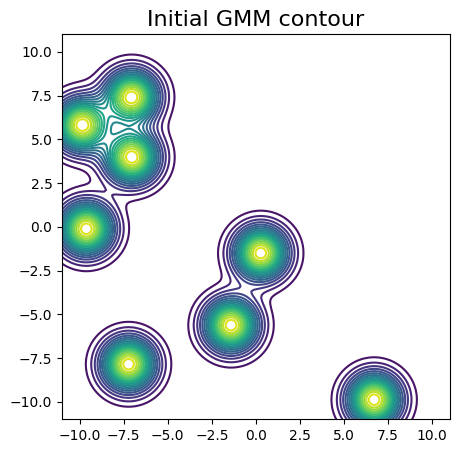

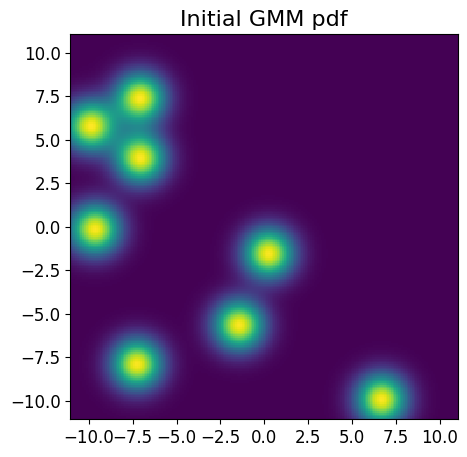

In [123]:
gmmEMVar = GMM_VariationalEM(N_COMPONENTS, 2).to(DEVICE)
draw_distrib(gmmEMVar.gmm_model, 'Initial GMM')

### 3.3 Train and test data

In [112]:
class FlowerGMM(GMM):

    def __init__(self):
        CENTERS_SCALE = 6.
        MAJOR_VAR = 3.
        MINOR_VAR = 1.
        r_angles = np.linspace(0., 2 * np.pi, 7, endpoint=False)
        vs = np.array([[np.cos(ang), np.sin(ang)] for ang in r_angles])
        perp_vs = np.array([[-np.sin(ang), np.cos(ang)] for ang in r_angles])
        mus = np.array([[0., 0.],] + [CENTERS_SCALE * v for v in vs])
        R_matrices = np.stack([vs, perp_vs], axis=1)
        petal_sigmas = np.array([[MAJOR_VAR, 0.], [0., MINOR_VAR]])[np.newaxis,...].repeat(7, axis=0)
        sigmas = np.concatenate([
            np.eye(2)[np.newaxis,...], 
            R_matrices.transpose(0, 2, 1) @ petal_sigmas @ R_matrices])
        super().__init__(8, 2, mu=mus, sigma=sigmas)
        # super().__init__(1, 2)
        
     

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


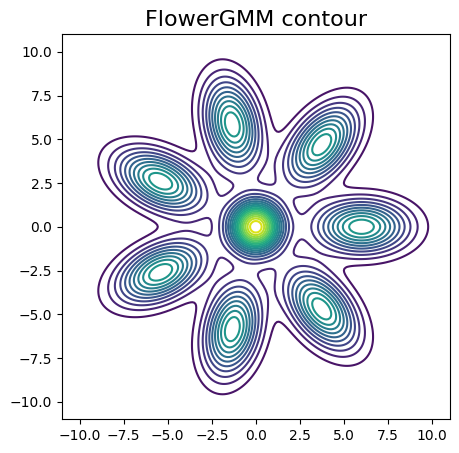

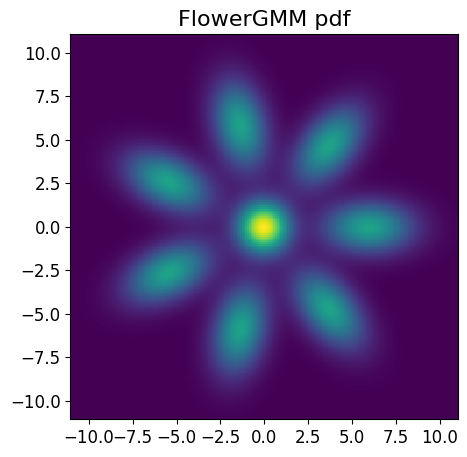

In [113]:
fgmm = FlowerGMM().to(DEVICE)
draw_distrib(fgmm, 'FlowerGMM')

In [114]:
torch.manual_seed(42)
train_data = fgmm.sample((20000,)).detach()
test_data = fgmm.sample((2000,)).detach()

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)


### 3.4 Training

In [115]:
def steps_counter(s0, s1, res0='E', res1='M'):
    assert res0 != res1
    curr_step = 0
    steps_passed = 0
    res_mapping = [res0, res1]
    while True:
        steps_passed += 1
        if curr_step == 0:
            if steps_passed > s0:
                curr_step = 1
                steps_passed = 1
        elif curr_step == 1:
            if steps_passed > s1:
                curr_step = 0
                steps_passed = 1
        yield res_mapping[curr_step]

In [116]:
SC = steps_counter(2, 3)
next(SC)

'E'

In [117]:
SC = steps_counter(2, 3)
print([next(SC) for _ in range(7)])

['E', 'E', 'M', 'M', 'M', 'E', 'E']


In [118]:
def train_GMM_VariationalEM_separate_manner(
    gmmEMVar, 
    train_loader, 
    epochs=20, 
    E_grad_steps = 1,
    M_grad_steps = 1,
    q_lr=1e-3, 
    p_theta_lr=1e-3, 
    use_tqdm=True, 
    use_cuda=False):

    SC = steps_counter(E_grad_steps, M_grad_steps)
    q_optimizer = optim.Adam(gmmEMVar.q.parameters(), lr=q_lr)
    p_theta_optimizer = optim.Adam(gmmEMVar.p_theta.parameters(), lr=p_theta_lr)

    forrange = tqdm(range(epochs)) if use_tqdm else range(epochs)

    if use_cuda:
        gmmEMVar = gmmEMVar.cuda()

    for epoch in forrange:

        if epoch % 4 == 0:
            draw_distrib(gmmEMVar.gmm_model, 'GMM_EM_Var, Separate, epoch {}'.format(epoch), density=False)

        for x in train_loader:
            x = x.float()
            if use_cuda:
                x = x.cuda()
            # EM алгоритм, в котором E и M шаги делаются на разных батчах по отдельности
            # E step
            if next(SC) == 'E':
                q_optimizer.zero_grad()
                E_loss = gmmEMVar.E_step_loss(x)
                E_loss.backward()
                q_optimizer.step()

            # M step
            else:
                p_theta_optimizer.zero_grad()
                M_loss = gmmEMVar.M_step_loss(x)
                M_loss.backward()
                p_theta_optimizer.step()

  0%|          | 0/200 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


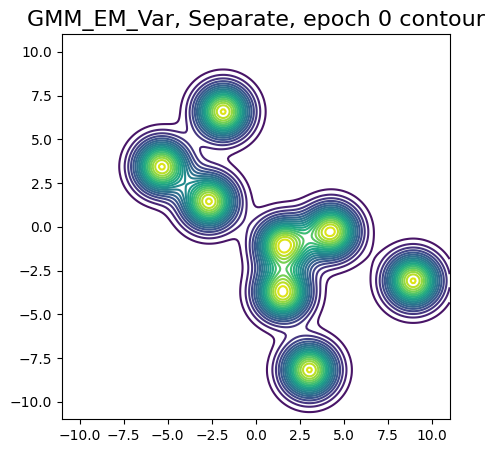

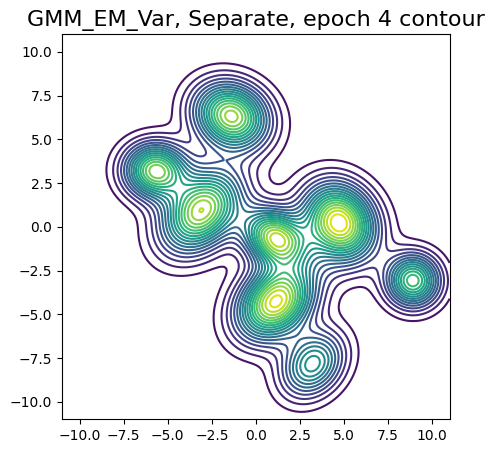

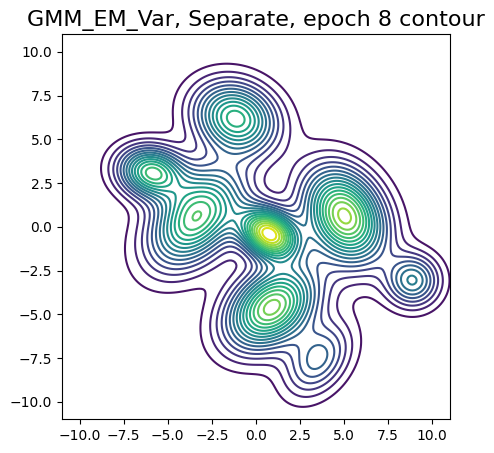

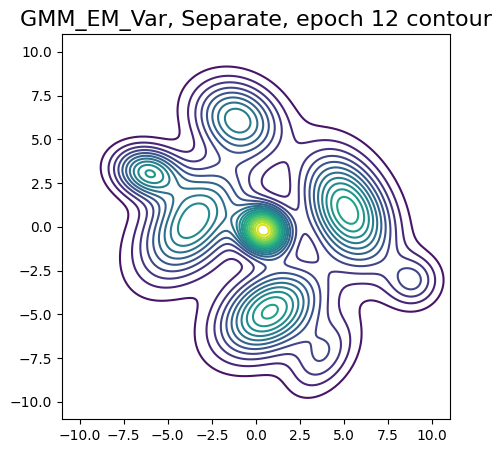

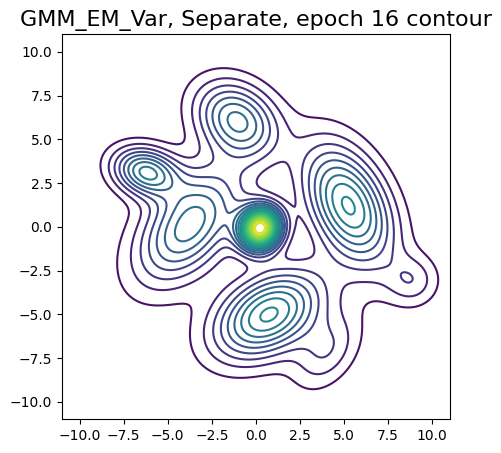

...

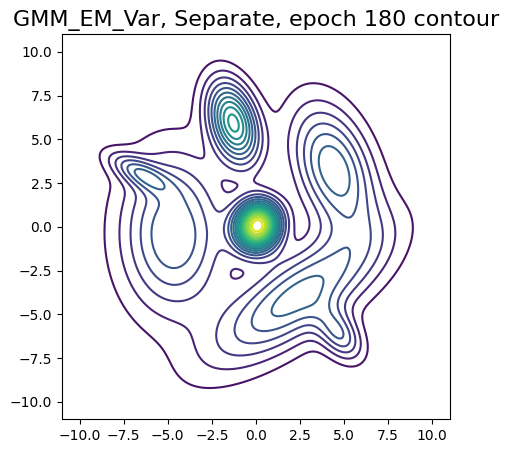

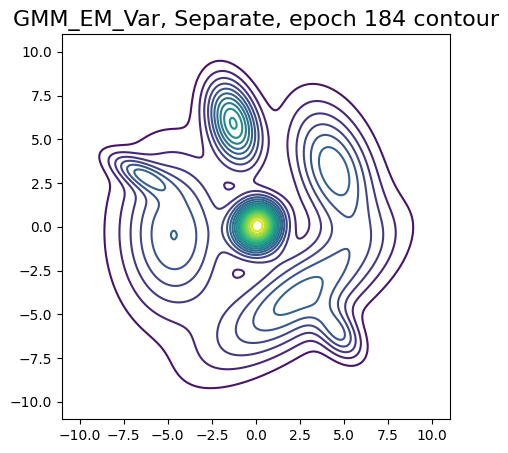

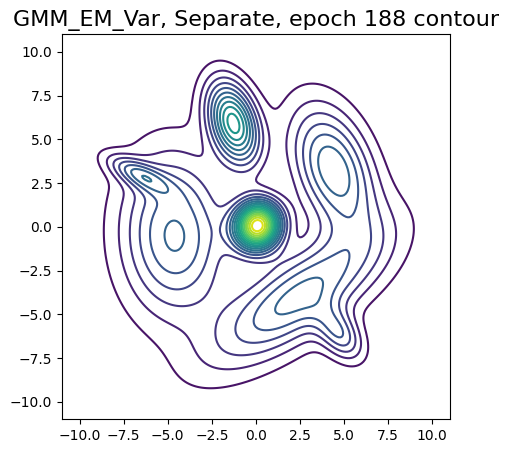

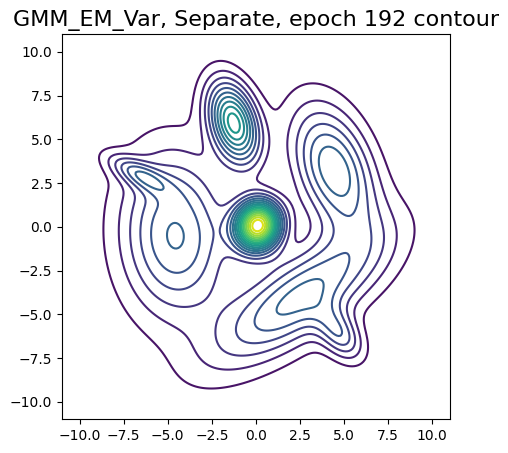

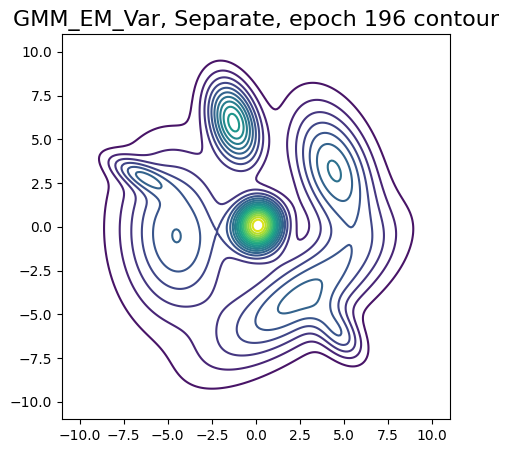

In [124]:
EPOCHS = 200
BATCH_SIZE = 64
Q_LR = 0.02
P_THETA_LR = 0.001
E_GRAD_STEPS = 1
M_GRAD_STEPS = 1
N_COMPONENTS = 8

gmmEMVar = GMM_VariationalEM(N_COMPONENTS, 2).to(DEVICE)

train_loader = torch.utils.data.DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)



train_GMM_VariationalEM_separate_manner(
    gmmEMVar, train_loader, EPOCHS, E_GRAD_STEPS, M_GRAD_STEPS, 
    Q_LR, P_THETA_LR, use_tqdm=True, use_cuda=False)

### Task:

Try  to vary parameters N_COMPONENTS,EPOCHS,E_GRAD_STEPS,M_GRAD_STEPS   and describe your results about convergence of the algorithm (1 pt)

My first think was that I should try small learning rates for $p(\theta)$ and $q$, high number of epochs and high batch size. Also one of the crucial parametrs is number of companents of gaussian companents. I think that it's very strange to chose this number lower than number of distributions for flower. Consequently, I chose it between 8-15.

In following cells will be provided results of model with different sets of parametrs

  0%|          | 0/200 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


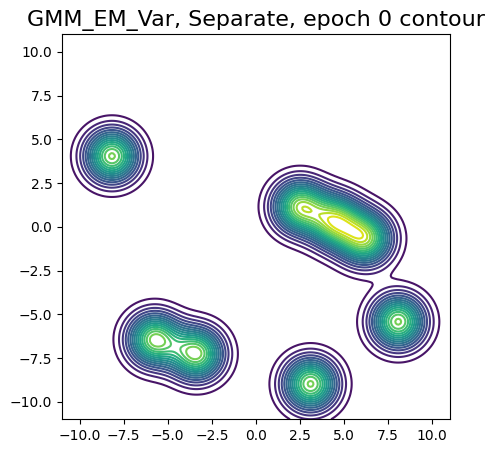

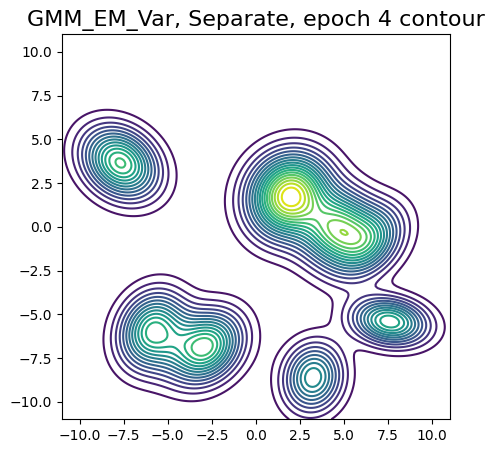

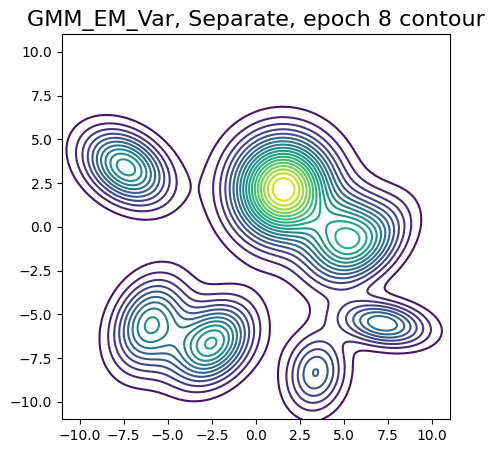

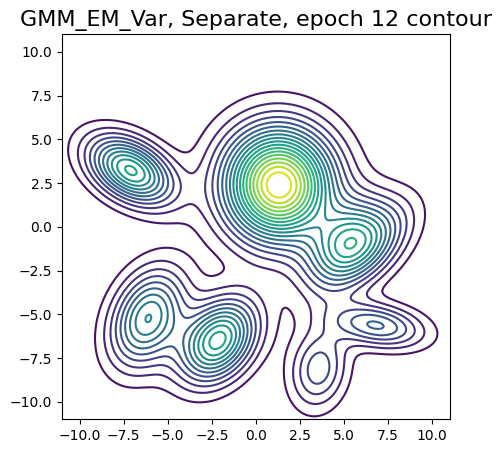

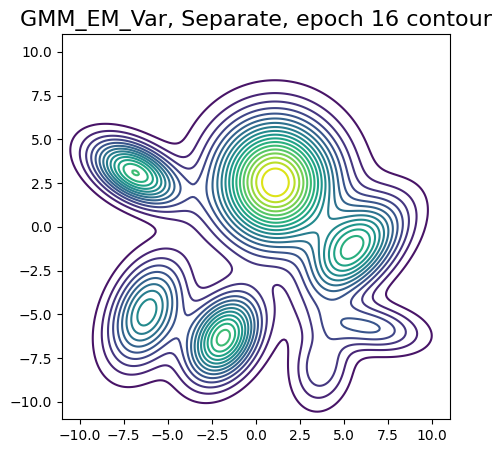

...

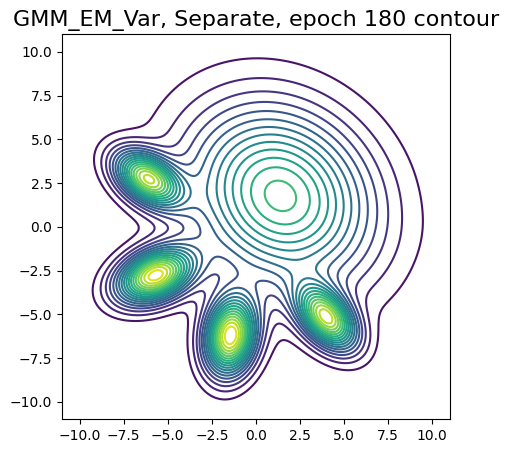

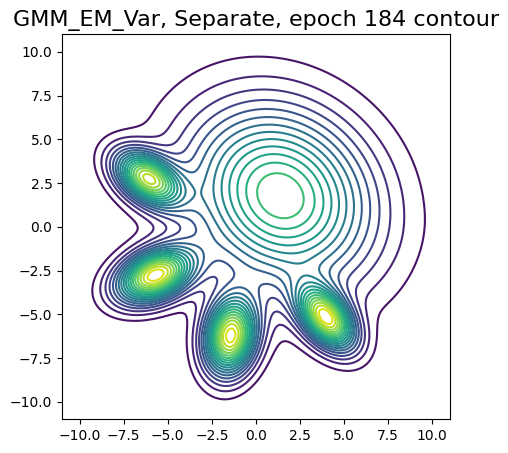

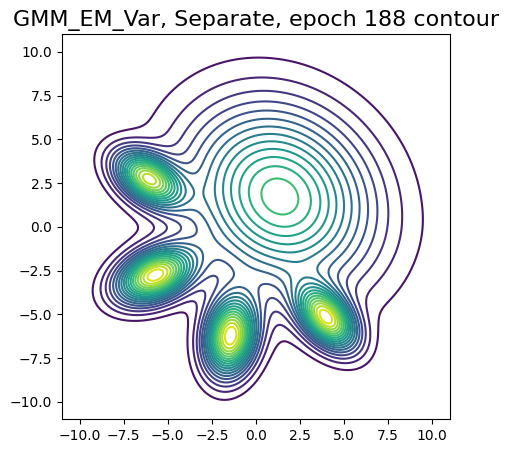

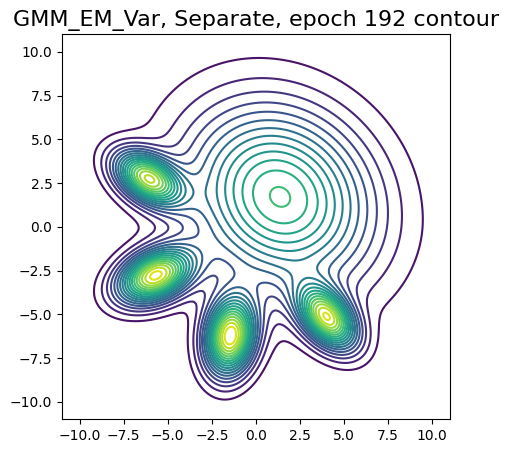

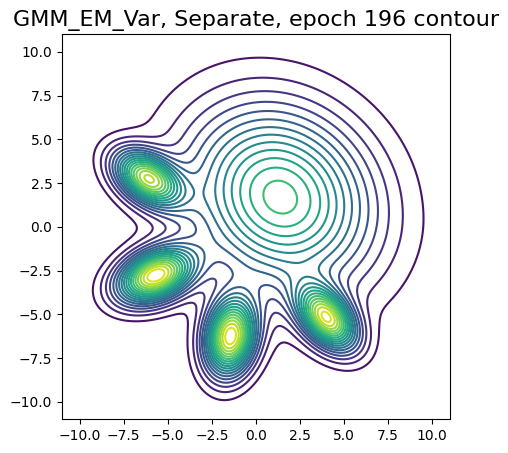

In [125]:
# first try
EPOCHS = 200
BATCH_SIZE = 64
Q_LR = 0.02
P_THETA_LR = 0.001
E_GRAD_STEPS = 1
M_GRAD_STEPS = 1
N_COMPONENTS = 8

gmmEMVar = GMM_VariationalEM(N_COMPONENTS, 2).to(DEVICE)

train_loader = torch.utils.data.DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)



train_GMM_VariationalEM_separate_manner(
    gmmEMVar, train_loader, EPOCHS, E_GRAD_STEPS, M_GRAD_STEPS, 
    Q_LR, P_THETA_LR, use_tqdm=True, use_cuda=False)

It is seen that there is not realy good results, despitesome some patterns (4 petals of the flower) found correctly, still there is no good general solution.

Let's try lower number of epochsm because model doesn't change significantly fron 40-50 epoch and increse a litle gradients steps.

  0%|          | 0/60 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


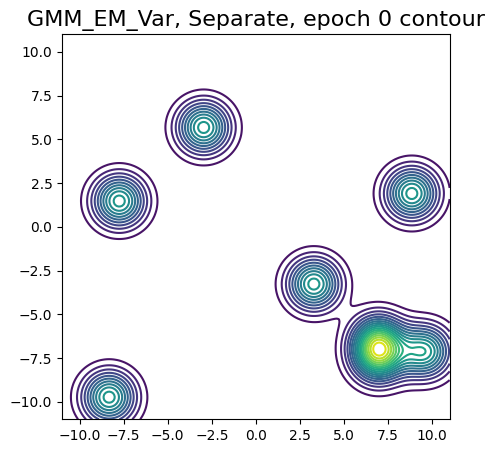

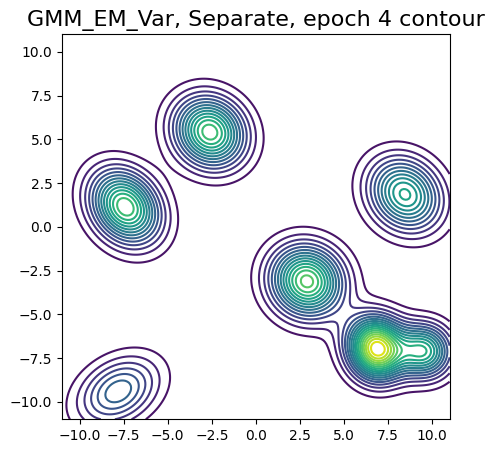

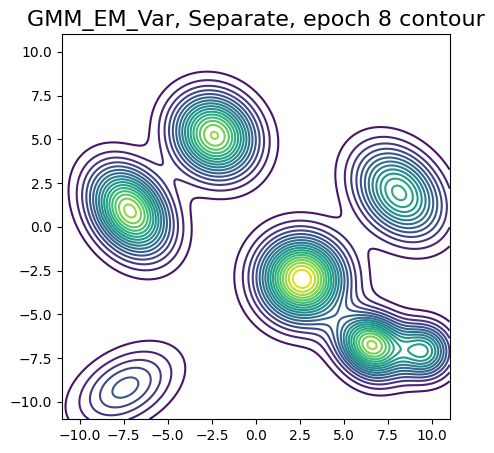

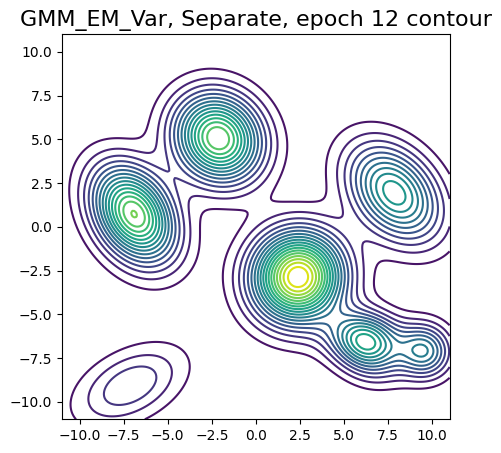

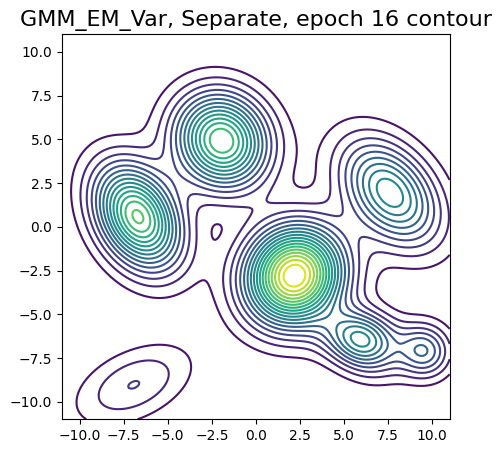

...

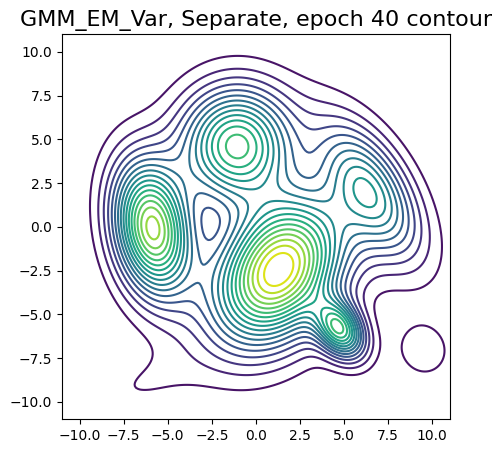

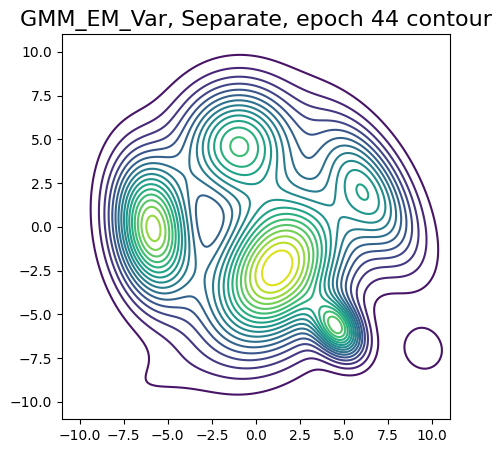

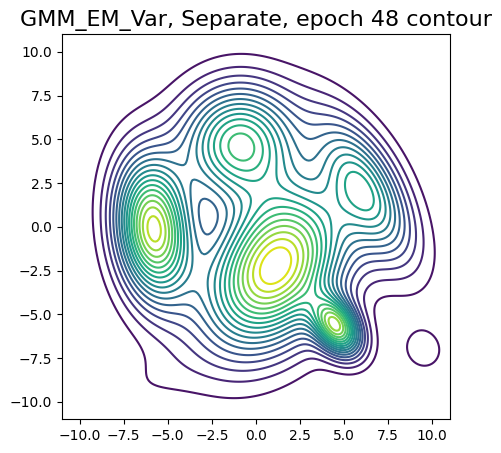

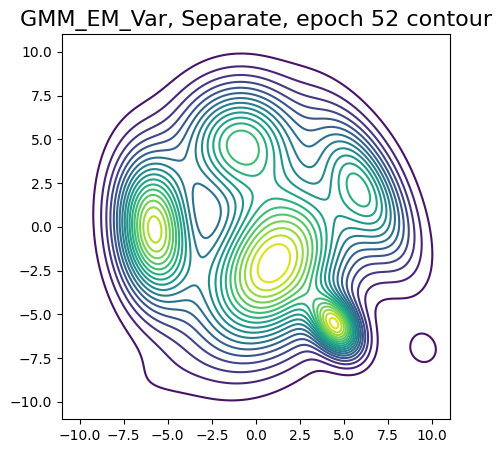

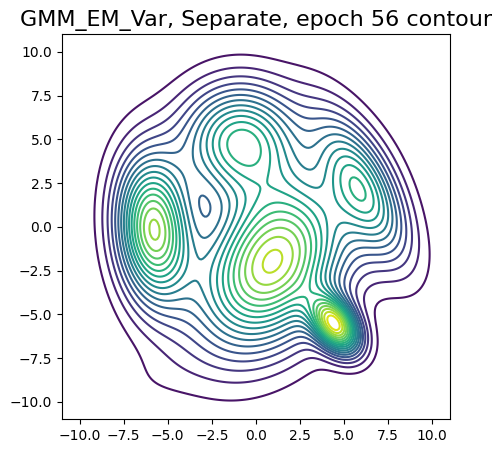

In [127]:
# second try
EPOCHS = 60
BATCH_SIZE = 64
Q_LR = 0.02
P_THETA_LR = 0.001
E_GRAD_STEPS = 2
M_GRAD_STEPS = 1
N_COMPONENTS = 8

gmmEMVar = GMM_VariationalEM(N_COMPONENTS, 2).to(DEVICE)

train_loader = torch.utils.data.DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)



train_GMM_VariationalEM_separate_manner(
    gmmEMVar, train_loader, EPOCHS, E_GRAD_STEPS, M_GRAD_STEPS, 
    Q_LR, P_THETA_LR, use_tqdm=True, use_cuda=False)

Here is resukts even worse, we didn;t see some sort of flower. No centre, no specific petals. Let's inrease number of componnents and one more step for M in gradient.

  0%|          | 0/60 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


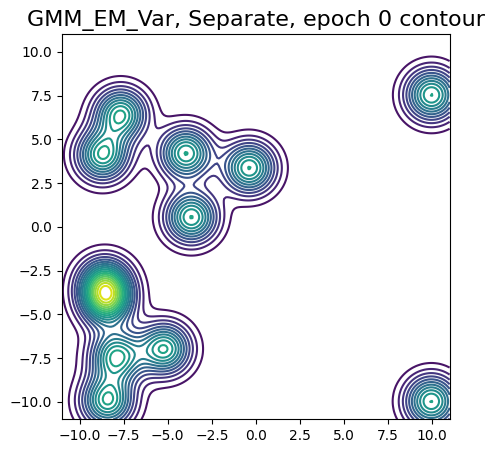

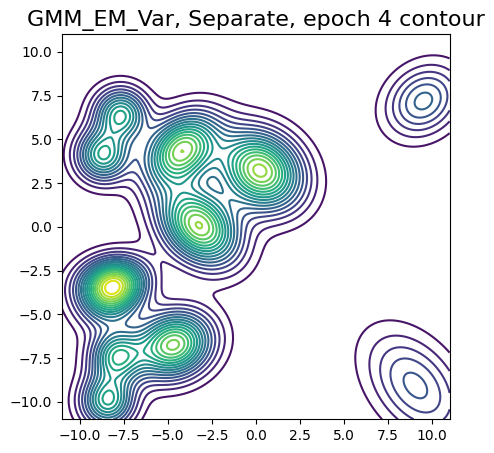

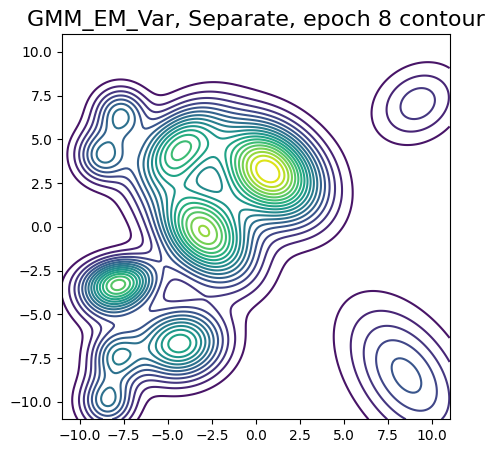

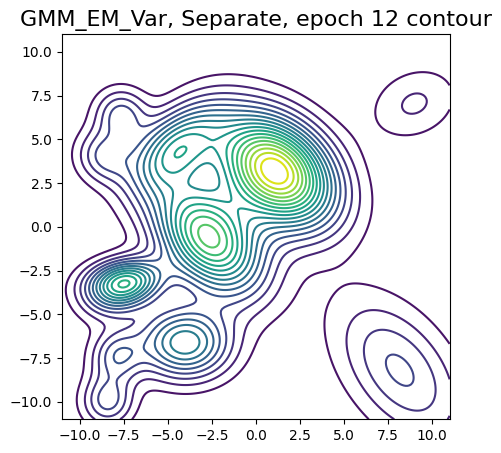

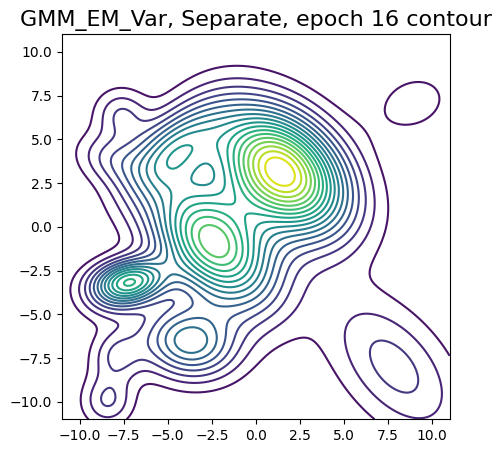

...

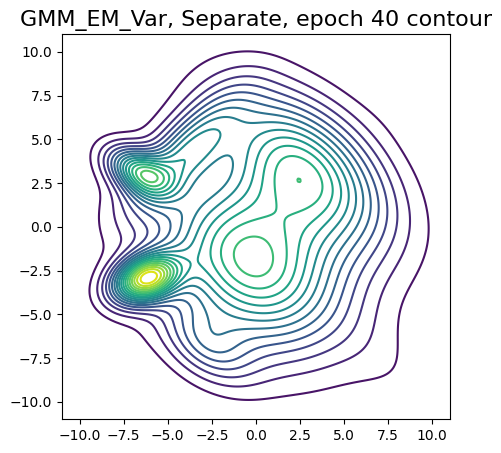

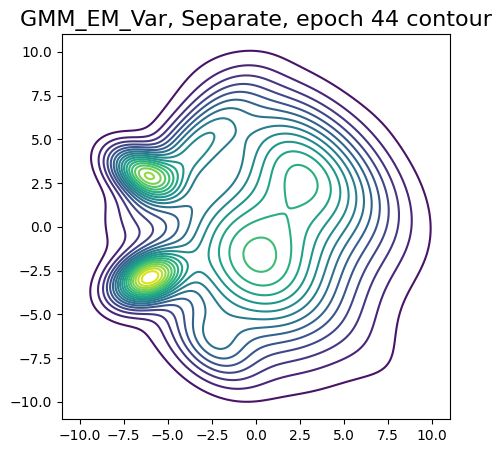

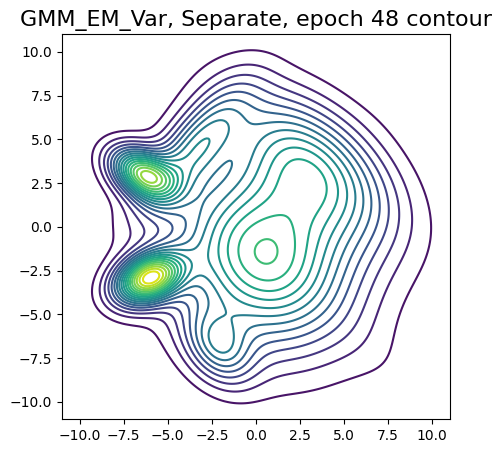

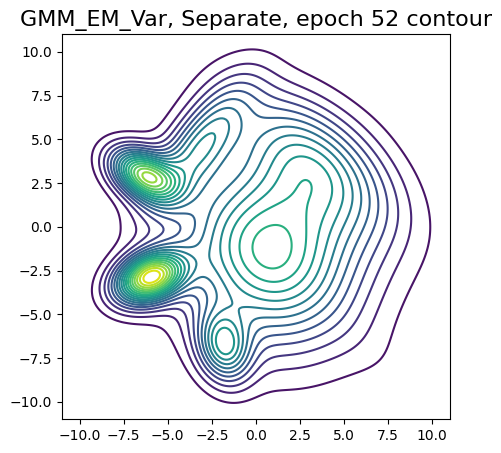

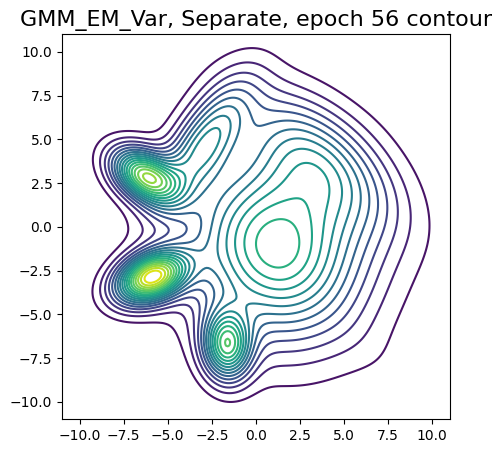

In [128]:
EPOCHS = 60
BATCH_SIZE = 64
Q_LR = 0.02
P_THETA_LR = 0.001
E_GRAD_STEPS = 2
M_GRAD_STEPS = 2
N_COMPONENTS = 12

gmmEMVar = GMM_VariationalEM(N_COMPONENTS, 2).to(DEVICE)

train_loader = torch.utils.data.DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)



train_GMM_VariationalEM_separate_manner(
    gmmEMVar, train_loader, EPOCHS, E_GRAD_STEPS, M_GRAD_STEPS, 
    Q_LR, P_THETA_LR, use_tqdm=True, use_cuda=False)

A bit better results, biut still no accurate result. Let's reduce Q_LR a bit. And dicrese a litlle batch_size to 32.

  0%|          | 0/60 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


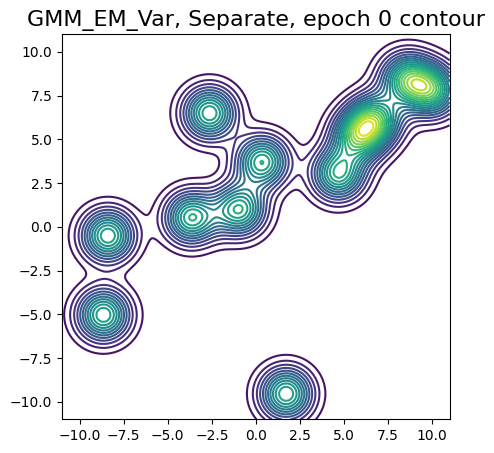

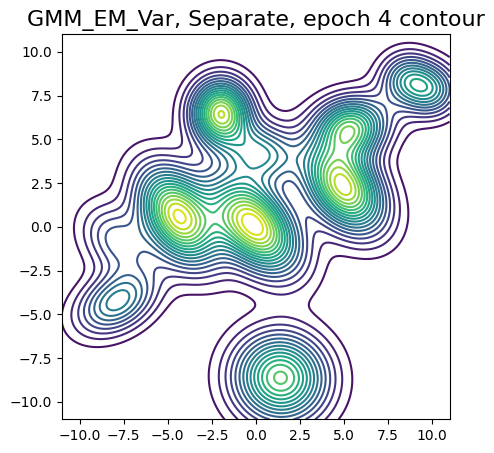

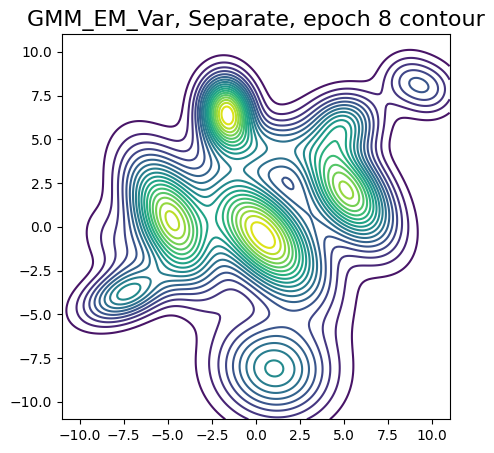

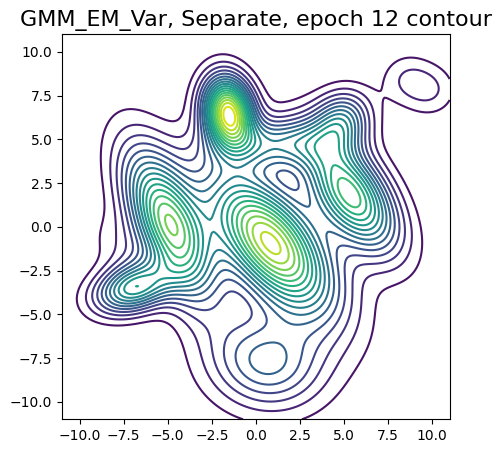

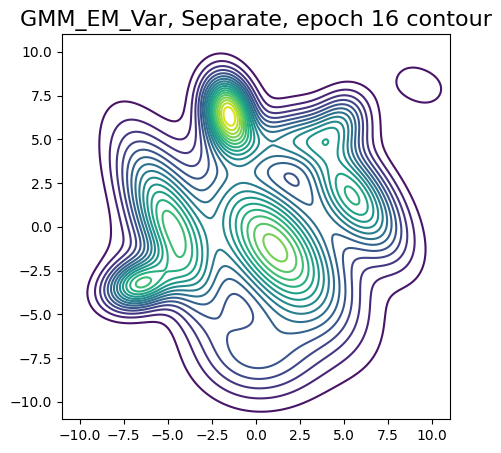

...

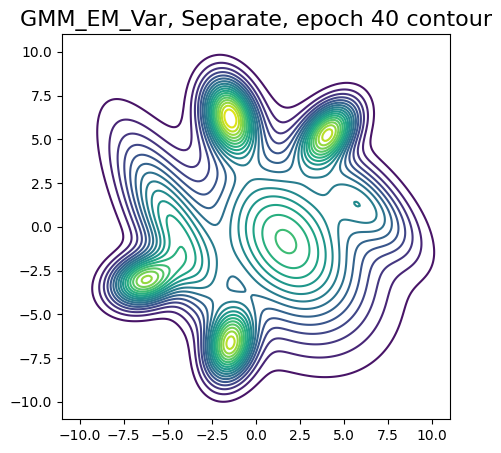

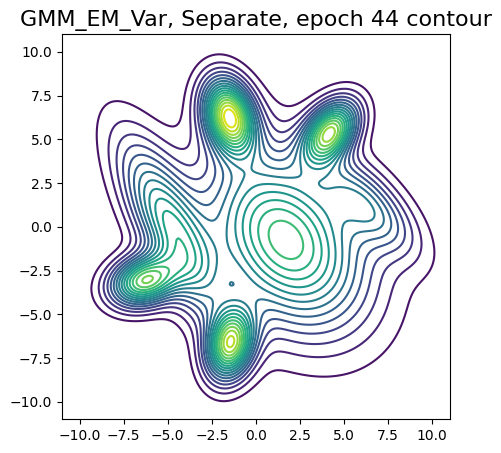

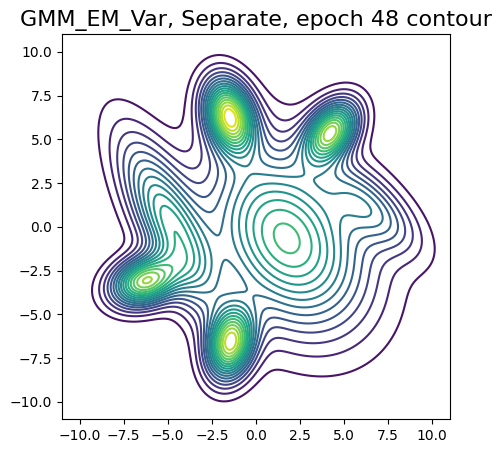

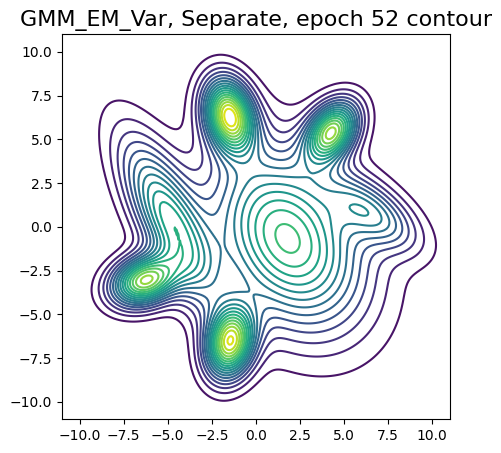

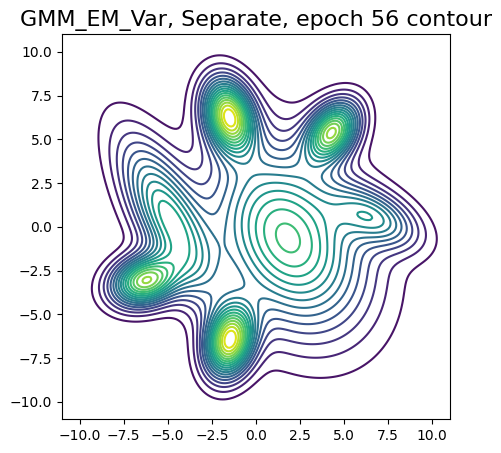

In [129]:
EPOCHS = 60
BATCH_SIZE = 32
Q_LR = 0.01
P_THETA_LR = 0.001
E_GRAD_STEPS = 2
M_GRAD_STEPS = 2
N_COMPONENTS = 12

gmmEMVar = GMM_VariationalEM(N_COMPONENTS, 2).to(DEVICE)

train_loader = torch.utils.data.DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)



train_GMM_VariationalEM_separate_manner(
    gmmEMVar, train_loader, EPOCHS, E_GRAD_STEPS, M_GRAD_STEPS, 
    Q_LR, P_THETA_LR, use_tqdm=True, use_cuda=False)

It seems that there is the best result for now. I think we should increase number of epochs and reduce a little all learning rates and let's reduce a litlle batch size.

  0%|          | 0/80 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


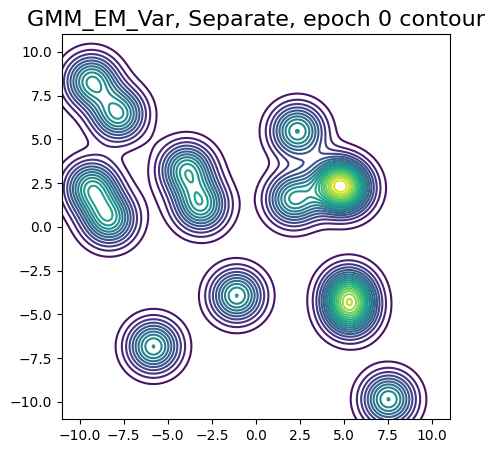

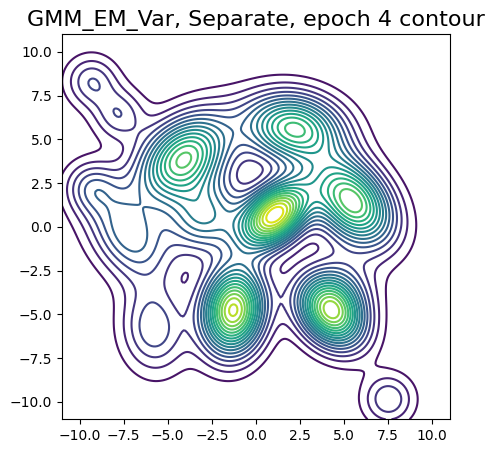

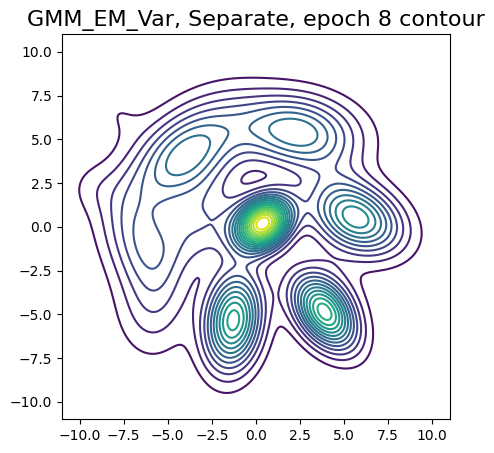

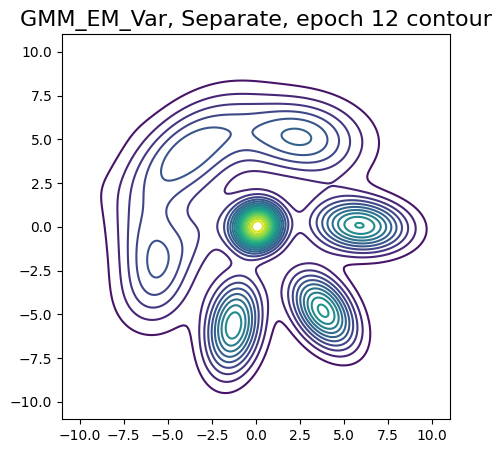

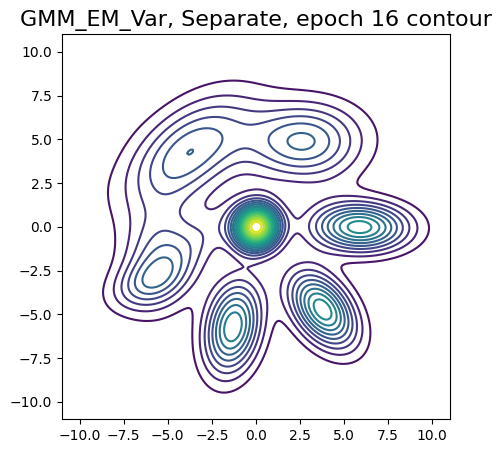

...

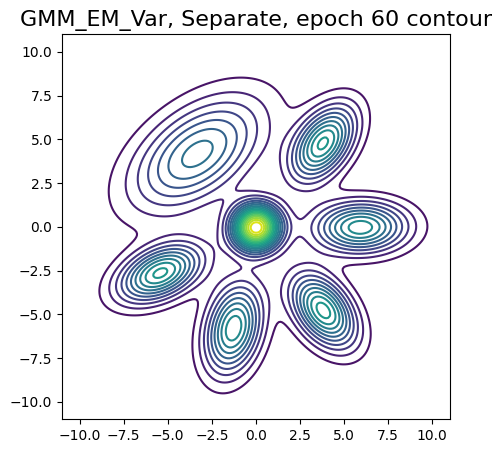

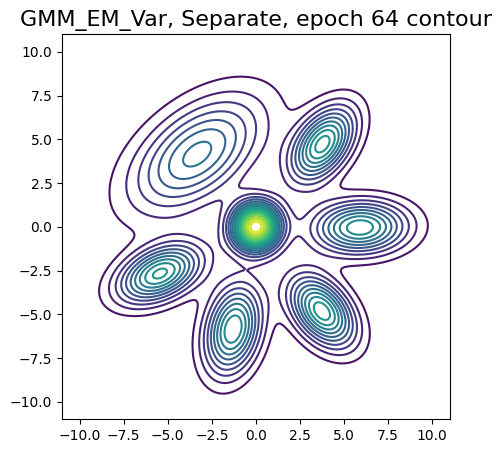

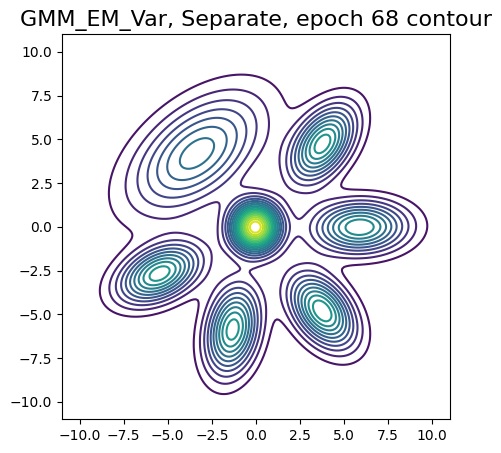

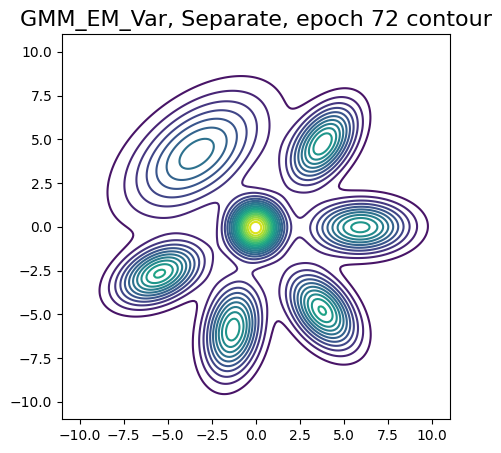

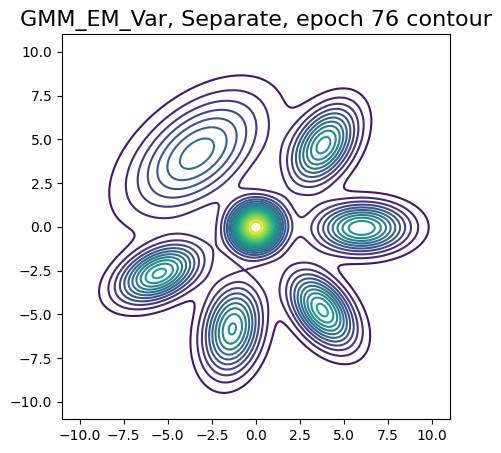

In [130]:
EPOCHS = 80
BATCH_SIZE = 16
Q_LR = 0.008
P_THETA_LR = 0.0008
E_GRAD_STEPS = 2
M_GRAD_STEPS = 2
N_COMPONENTS = 15

gmmEMVar = GMM_VariationalEM(N_COMPONENTS, 2).to(DEVICE)

train_loader = torch.utils.data.DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)



train_GMM_VariationalEM_separate_manner(
    gmmEMVar, train_loader, EPOCHS, E_GRAD_STEPS, M_GRAD_STEPS, 
    Q_LR, P_THETA_LR, use_tqdm=True, use_cuda=False)

Already on 12th epoch we can see some good result, but still no direct solution. Model didn't catch last part of flower, despite very goog general result for other part of the flower. 
Moreoverm number of epochs is too much, let's decrese it and make learning rates bigger, let's continue with start learning rates.

  0%|          | 0/40 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


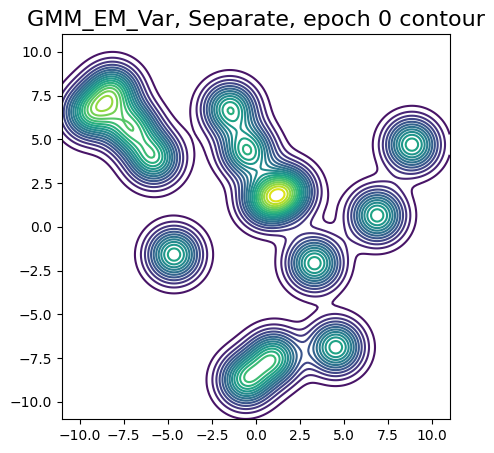

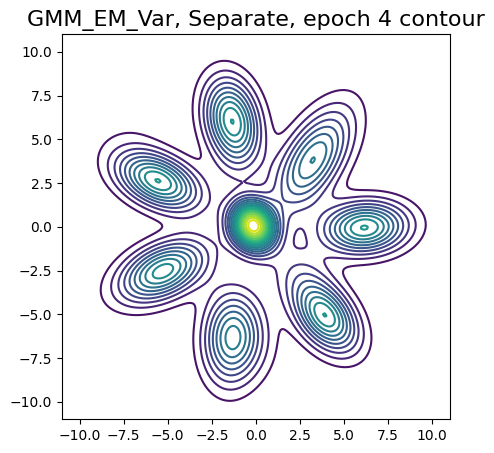

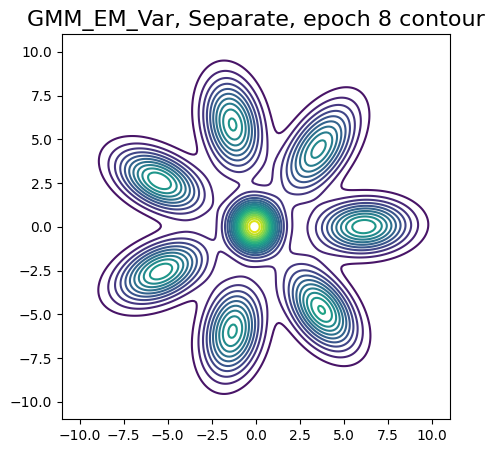

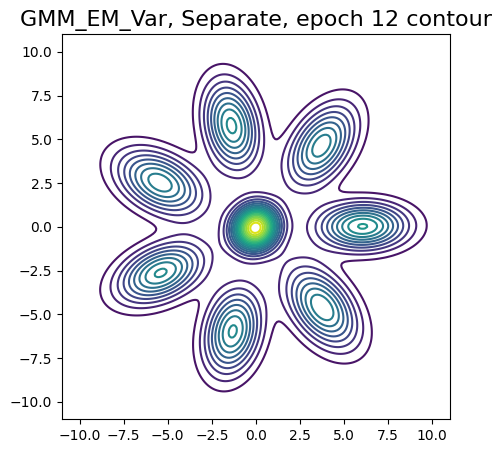

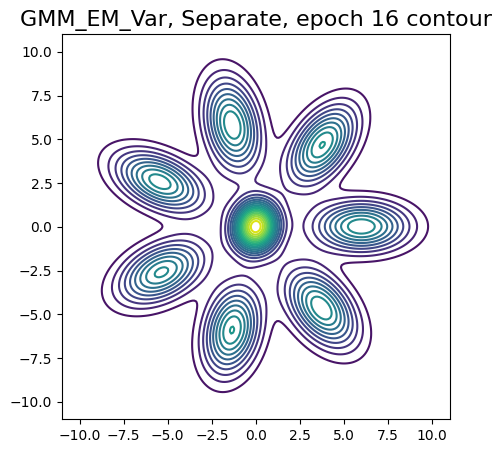

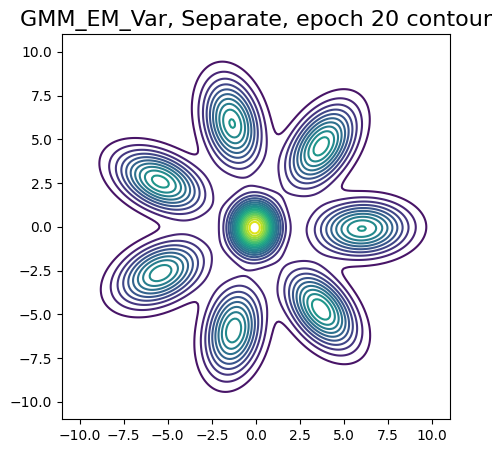

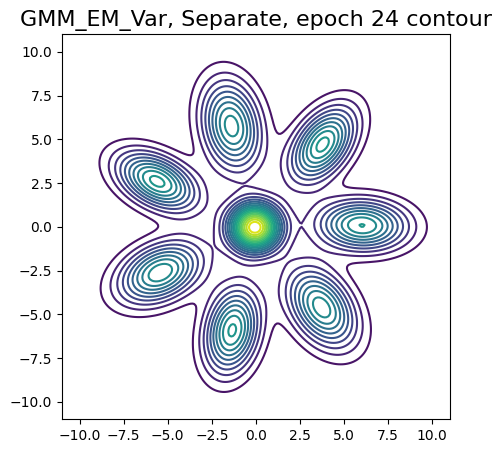

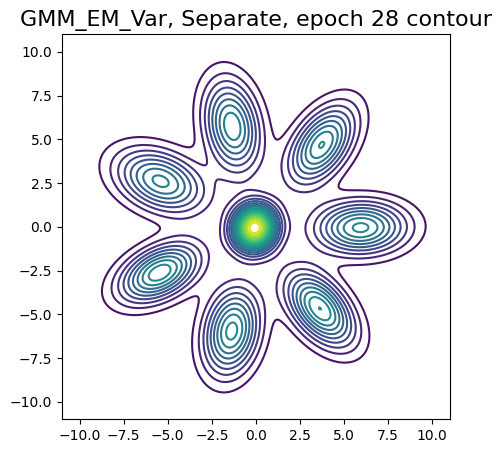

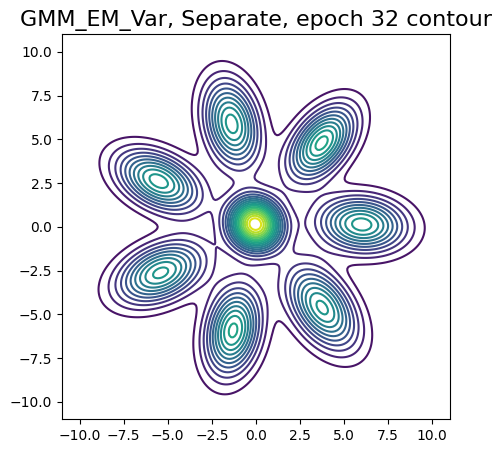

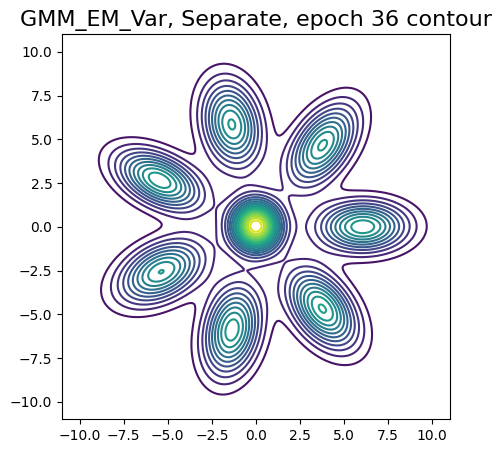

In [131]:
EPOCHS = 40
BATCH_SIZE = 16
Q_LR = 0.01
P_THETA_LR = 0.002
E_GRAD_STEPS = 2
M_GRAD_STEPS = 2
N_COMPONENTS = 15

gmmEMVar = GMM_VariationalEM(N_COMPONENTS, 2).to(DEVICE)

train_loader = torch.utils.data.DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)



train_GMM_VariationalEM_separate_manner(
    gmmEMVar, train_loader, EPOCHS, E_GRAD_STEPS, M_GRAD_STEPS, 
    Q_LR, P_THETA_LR, use_tqdm=True, use_cuda=False)

Already on 4th epoch almost direct solutuion and on 20th exact solution. Model even overfites in the end of 40th epoch. 
Let's make final cut - decrease number of epoch.

  0%|          | 0/21 [00:00<?, ?it/s]

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/353451793.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(self._log_pi)
/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_2256/3206462172.py:5: UserWarning: The following kwargs were not used by contour: 'c'
  plt.contour(X, Y, density, levels=levels, c='red')


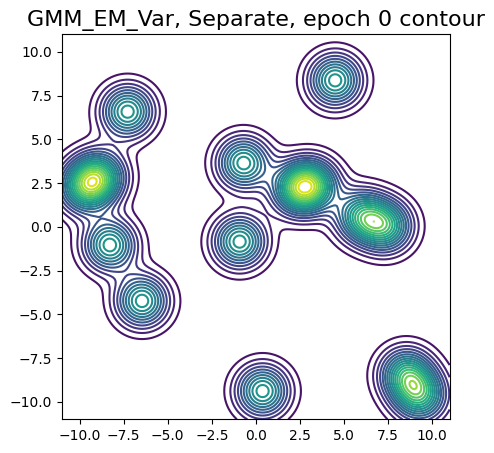

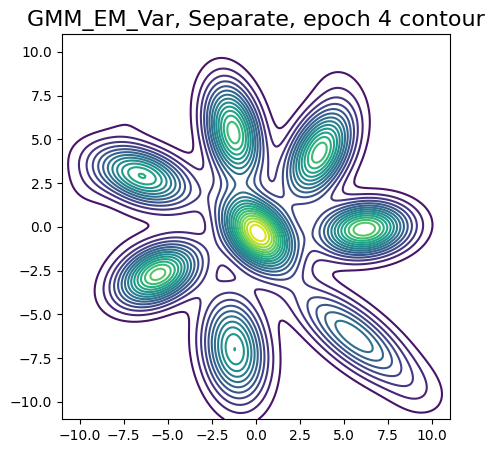

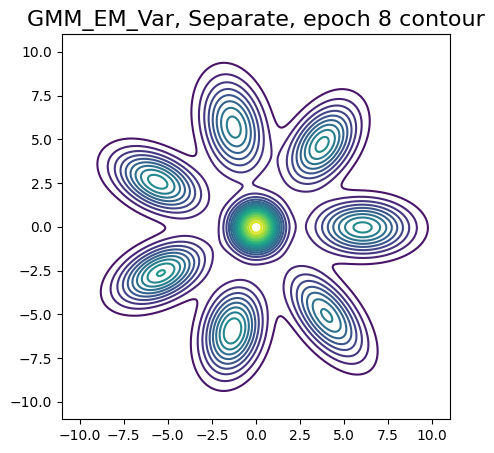

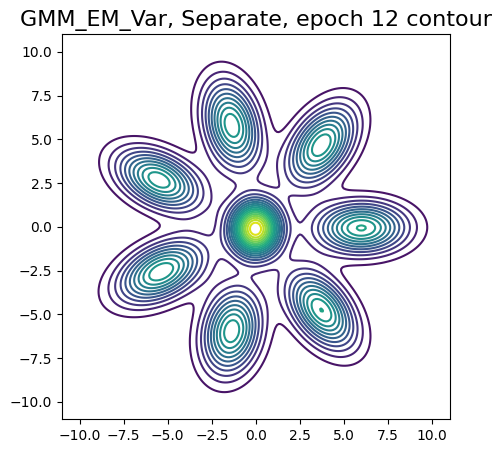

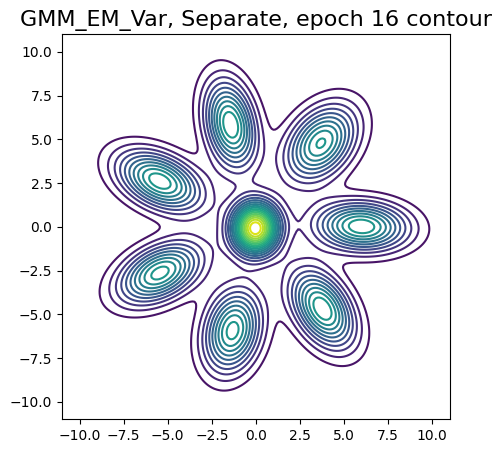

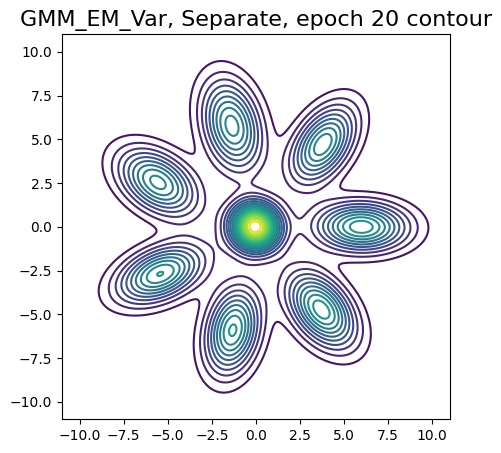

In [136]:
EPOCHS = 21
BATCH_SIZE = 16
Q_LR = 0.01
P_THETA_LR = 0.002
E_GRAD_STEPS = 2
M_GRAD_STEPS = 2
N_COMPONENTS = 15

gmmEMVar = GMM_VariationalEM(N_COMPONENTS, 2).to(DEVICE)

train_loader = torch.utils.data.DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)



train_GMM_VariationalEM_separate_manner(
    gmmEMVar, train_loader, EPOCHS, E_GRAD_STEPS, M_GRAD_STEPS, 
    Q_LR, P_THETA_LR, use_tqdm=True, use_cuda=False)

Almost the same as the previuos result.


But also it should de mentioned that very crucial for convergnece is sampling and positions of components. For some tests exactly with same parametrs models doesnt converge well because of not good position of components of the distribution. But still with secific set of parametrs models provide greate results.

------------------------------------------------------